In [1]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 6.5 MB/s eta 0:00:00


In [2]:
!pip install optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 379.9/379.9 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 25.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 4.5 MB/s eta 0:00:00


In [20]:
import pandas as pd
from google.colab import drive
from keras.models import Sequential
from keras.layers import Conv1D, Dense, Flatten, Reshape, Dropout, BatchNormalization, MaxPooling1D
from sklearn.model_selection import LeaveOneOut
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import shap
from sklearn.model_selection import train_test_split
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping, ModelCheckpoint
import optuna
from keras.regularizers import l1, l2, l1_l2
from keras.layers import LSTM, Dense
from keras.optimizers import Adam

In [4]:
drive.mount('/content/drive')

df = pd.read_excel('/content/drive/MyDrive/TCC/RMS INDEPENDENTES.xlsx', sheet_name='JEITO 7 com variações')

Mounted at /content/drive


# Processamento dos Dados

In [5]:
#df_tratado = df.iloc[:, 0:8]
df_tratado = df.iloc[:, 1:8]
df_rms = df.iloc[:, 0]

In [6]:
print(df_tratado)
print(df_rms)

            IRI   V       k       c       ms    mus     kus
0      1.722854  30   14000  1876.0  186.750   41.5  200000
1      1.530687  30   14000  1876.0  186.750   41.5  200000
2      1.559335  30   14000  1876.0  186.750   41.5  200000
3      1.575025  30   14000  1876.0  186.750   41.5  200000
4      1.690348  30   14000  1876.0  186.750   41.5  200000
...         ...  ..     ...     ...      ...    ...     ...
48649  1.000000  30  107900  4616.3  592.475  130.0  299000
48650  1.000000  30  169000  6745.7  464.825  104.0  299000
48651  1.000000  30  169650  4616.3  331.500   78.0  299000
48652  1.000000  30   52000  6745.7  500.750   91.0  299000
48653  1.000000  30   40300  2993.3  357.500  130.0  260000

[48654 rows x 7 columns]
0        0.374902
1        0.312542
2        0.299262
3        0.326102
4        0.425370
           ...   
48649    1.000000
48650    1.000000
48651    1.000000
48652    1.000000
48653    1.000000
Name: RMS, Length: 48654, dtype: float64


In [26]:
scaler = MinMaxScaler()
df_norm = scaler.fit_transform(df_tratado)


In [35]:
data = scaler.fit_transform(df_tratado)
data = data[:-54]

In [36]:
print(len(data))

48600


In [8]:
nome_coluna = df_rms.name

# Aplicando a transformação no array numpy
array_rms = df_rms.values.reshape(-1, 1)
array_rms_scaled = scaler.fit_transform(array_rms)

# Criando um novo DataFrame pandas mantendo o nome da coluna original
df_rms = pd.DataFrame(array_rms_scaled, columns=[nome_coluna])

In [9]:
ultimas_linhas = df_norm[-54:]

df_ultimas = pd.DataFrame(ultimas_linhas)

df_ultimas.to_excel('ultimas_54_linhas.xlsx', index=False)

df_norm = df_norm[:-54]

df_rms = df_rms.iloc[:-54]

In [10]:
print(df_norm)
print(df_rms)

[[0.17507015 0.         0.02221047 ... 0.12133189 0.12332838 0.37735849]
 [0.14772091 0.         0.02221047 ... 0.12133189 0.12332838 0.37735849]
 [0.1517981  0.         0.02221047 ... 0.12133189 0.12332838 0.37735849]
 ...
 [0.21042462 1.         0.11210999 ... 0.31245263 0.70282318 0.37735849]
 [0.4029404  1.         0.11210999 ... 0.31245263 0.70282318 0.37735849]
 [0.16712854 1.         0.11210999 ... 0.31245263 0.70282318 0.37735849]]
            RMS
0      0.045682
1      0.036110
2      0.034071
3      0.038191
4      0.053429
...         ...
48595  0.217583
48596  0.216008
48597  0.313292
48598  0.257720
48599  0.221763

[48600 rows x 1 columns]


In [11]:
df_norm = pd.DataFrame(df_norm, columns=df.columns[1:8])

df_norm['VEICULO'] = df.reset_index(drop=True)['VEICULO']

#nome_coluna = df_rms.name

df_norm.insert(0, nome_coluna, df_rms)

In [12]:
print(df_norm)

            RMS       IRI    V        k         c        ms       mus  \
0      0.045682  0.175070  0.0  0.02221  0.103632  0.121332  0.123328   
1      0.036110  0.147721  0.0  0.02221  0.103632  0.121332  0.123328   
2      0.034071  0.151798  0.0  0.02221  0.103632  0.121332  0.123328   
3      0.038191  0.154031  0.0  0.02221  0.103632  0.121332  0.123328   
4      0.053429  0.170444  0.0  0.02221  0.103632  0.121332  0.123328   
...         ...       ...  ...      ...       ...       ...       ...   
48595  0.217583  0.325042  1.0  0.11211  0.181862  0.312453  0.702823   
48596  0.216008  0.316123  1.0  0.11211  0.181862  0.312453  0.702823   
48597  0.313292  0.210425  1.0  0.11211  0.181862  0.312453  0.702823   
48598  0.257720  0.402940  1.0  0.11211  0.181862  0.312453  0.702823   
48599  0.221763  0.167129  1.0  0.11211  0.181862  0.312453  0.702823   

            kus       VEICULO  
0      0.377358          A-HB  
1      0.377358          A-HB  
2      0.377358          A-

In [13]:
grupos = df_norm.groupby('VEICULO')

df_A_HB = grupos.get_group('A-HB').iloc[:, 0:8] if 'A-HB' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_B_HB = grupos.get_group('B-HB').iloc[:, 0:8] if 'B-HB' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_C_HB = grupos.get_group('C-HB').iloc[:, 0:8] if 'C-HB' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_D_SDN = grupos.get_group('D-SDN').iloc[:, 0:8] if 'D-SDN' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_F_SDN = grupos.get_group('F-SDN').iloc[:, 0:8] if 'F-SDN' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_D_SUV = grupos.get_group('D-SUV').iloc[:, 0:8] if 'D-SUV' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_B_SPORTS = grupos.get_group('B-SPORTS').iloc[:, 0:8] if 'B-SPORTS' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_STOCKCAR = grupos.get_group('STOCKCAR').iloc[:, 0:8] if 'STOCKCAR' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])
df_EUROPEAN_VAN = grupos.get_group('EUROPEAN VAN').iloc[:, 0:8] if 'EUROPEAN VAN' in grupos.groups else pd.DataFrame(columns=df.columns[0:9])

In [14]:
print(df_B_HB)

            RMS       IRI    V         k        c        ms       mus  \
540    0.042827  0.175070  0.0  0.096245  0.41195  0.318408  0.306587   
541    0.034344  0.147721  0.0  0.096245  0.41195  0.318408  0.306587   
542    0.033955  0.151798  0.0  0.096245  0.41195  0.318408  0.306587   
543    0.035082  0.154031  0.0  0.096245  0.41195  0.318408  0.306587   
544    0.048365  0.170444  0.0  0.096245  0.41195  0.318408  0.306587   
...         ...       ...  ...       ...      ...       ...       ...   
44815  0.247789  0.325042  1.0  0.096245  0.41195  0.318408  0.306587   
44816  0.247022  0.316123  1.0  0.096245  0.41195  0.318408  0.306587   
44817  0.341767  0.210425  1.0  0.096245  0.41195  0.318408  0.306587   
44818  0.288468  0.402940  1.0  0.096245  0.41195  0.318408  0.306587   
44819  0.231975  0.167129  1.0  0.096245  0.41195  0.318408  0.306587   

            kus  
540    0.566038  
541    0.566038  
542    0.566038  
543    0.566038  
544    0.566038  
...         ...

In [15]:
X = df_norm.iloc[:, 1:8]
#y = df_norm.iloc[:, 0]
#y = df.iloc[:-54, 0]
y = df_rms

In [16]:
print(df_norm)

            RMS       IRI    V        k         c        ms       mus  \
0      0.045682  0.175070  0.0  0.02221  0.103632  0.121332  0.123328   
1      0.036110  0.147721  0.0  0.02221  0.103632  0.121332  0.123328   
2      0.034071  0.151798  0.0  0.02221  0.103632  0.121332  0.123328   
3      0.038191  0.154031  0.0  0.02221  0.103632  0.121332  0.123328   
4      0.053429  0.170444  0.0  0.02221  0.103632  0.121332  0.123328   
...         ...       ...  ...      ...       ...       ...       ...   
48595  0.217583  0.325042  1.0  0.11211  0.181862  0.312453  0.702823   
48596  0.216008  0.316123  1.0  0.11211  0.181862  0.312453  0.702823   
48597  0.313292  0.210425  1.0  0.11211  0.181862  0.312453  0.702823   
48598  0.257720  0.402940  1.0  0.11211  0.181862  0.312453  0.702823   
48599  0.221763  0.167129  1.0  0.11211  0.181862  0.312453  0.702823   

            kus       VEICULO  
0      0.377358          A-HB  
1      0.377358          A-HB  
2      0.377358          A-

In [17]:
print(X)
print(y)

            IRI    V        k         c        ms       mus       kus
0      0.175070  0.0  0.02221  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.02221  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.02221  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.02221  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.02221  0.103632  0.121332  0.123328  0.377358
...         ...  ...      ...       ...       ...       ...       ...
48595  0.325042  1.0  0.11211  0.181862  0.312453  0.702823  0.377358
48596  0.316123  1.0  0.11211  0.181862  0.312453  0.702823  0.377358
48597  0.210425  1.0  0.11211  0.181862  0.312453  0.702823  0.377358
48598  0.402940  1.0  0.11211  0.181862  0.312453  0.702823  0.377358
48599  0.167129  1.0  0.11211  0.181862  0.312453  0.702823  0.377358

[48600 rows x 7 columns]
            RMS
0      0.045682
1      0.036110
2      0.034071
3      0.038191
4      0.053429
...         ...
48595  0.217583
48596 

#Modelo Conv1D com normalização

In [44]:
X_train, X_val, y_train, y_val = train_test_split(X, y,test_size=0.2, random_state=42)

In [19]:
def create_model(trial):
    # Hiperparâmetros a serem otimizados
    dropout_rate = trial.suggest_float('dropout_rate', 0.0, 0.5)
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)

    # Construção do modelo
    model = Sequential([
        Conv1D(filters=8, kernel_size=8, input_shape=(X_train.shape[1], 1), activation='relu', padding='same'),
        Flatten(),
        Dense(16, activation='relu'),
        Dropout(dropout_rate),
        Dense(units=1, activation='relu')
    ])

    # Compilação do modelo
    model.compile(optimizer=Adam(learning_rate=learning_rate), loss='mean_squared_error')

    return model

def objective(trial):
    # Criação do modelo com os hiperparâmetros sugeridos
    model = create_model(trial)

    # Hiperparâmetro do tamanho do lote a ser otimizado
    batch_size = trial.suggest_int('batch_size', 16, 128)

    # Treinamento do modelo
    model.fit(X_train, y_train,
              epochs=30,
              batch_size=batch_size,
              validation_data=(X_val, y_val),
              callbacks=[EarlyStopping(patience=3, restore_best_weights=True)],
              verbose=0)

    # Avaliação do modelo
    loss = model.evaluate(X_val, y_val, verbose=0)

    return loss

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)

# Melhores hiperparâmetros
print(study.best_trial.params)

[I 2024-04-01 05:55:23,299] A new study created in memory with name: no-name-1657fe2c-5d95-4959-aa77-fec405f4162c
[W 2024-04-01 05:55:25,704] Trial 0 failed with parameters: {'dropout_rate': 0.3374938085857751, 'learning_rate': 0.00012631851069533681, 'batch_size': 58} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/optuna/study/_optimize.py", line 196, in _run_trial
    value_or_values = func(trial)
  File "<ipython-input-19-0861f14fff26>", line 28, in objective
    model.fit(X_train, y_train,
  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler
    return fn(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1807, in fit
    tmp_logs = self.train_function(iterator)
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/util/traceback_utils.py", line 150, in error_handler
    retur

KeyboardInterrupt: 

In [41]:
def create_sequences(data, time_steps=5):
    X, y = [], []
    for i in range(len(data) - time_steps):
        v = data[i:(i + time_steps)]
        X.append(v)
        y.append(data[i + time_steps])
    return np.array(X), np.array(y)

# Supondo que 'data' é o seu array original de características
# Você precisará chamar essa função para cada uma das suas séries temporais (features) se elas forem independentes
X, y = create_sequences(data, time_steps=5)

In [42]:
print(X.shape)

(48595, 5, 7)


In [45]:
modelo = Sequential()
modelo.add(LSTM(50, activation='relu', input_shape=(X.shape[1], X.shape[2])))
modelo.add(Dense(1))
modelo.compile(optimizer='adam', loss='mean_squared_error')

# Definindo os callbacks
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ModelCheckpoint('melhor_modelo_lstm.h5', monitor='val_loss', save_best_only=True, mode='min', verbose=1)
]

# Supondo que você tenha uma divisão de dados de treino e validação
# Substitua 'X_train', 'y_train', 'X_val', 'y_val' pelos seus conjuntos de dados
modelo.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_val, y_val), callbacks=callbacks)

# Para fazer previsões e avaliar o modelo, você pode usar:
y_pred = modelo.predict(X_val)
mse = mean_squared_error(y_val, y_pred)
r2 = r2_score(y_val, y_pred)
print(f'Mean Squared Error (MSE): {mse:.3f}')
print(f'R^2 Score: {r2:.3f}')

Epoch 1/100
1210/1215 [============================>.] - ETA: 0s - loss: 0.0425
Epoch 1: val_loss improved from inf to 0.04232, saving model to melhor_modelo_lstm.h5
1215/1215 [==============================] - 8s 6ms/step - loss: 0.0425 - val_loss: 0.0423
Epoch 2/100
  29/1215 [..............................] - ETA: 6s - loss: 0.0405

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1208/1215 [============================>.] - ETA: 0s - loss: 0.0417
Epoch 2: val_loss did not improve from 0.04232
1215/1215 [==============================] - 6s 5ms/step - loss: 0.0417 - val_loss: 0.0423
Epoch 3/100
1208/1215 [============================>.] - ETA: 0s - loss: 0.0417
Epoch 3: val_loss improved from 0.04232 to 0.04230, saving model to melhor_modelo_lstm.h5
1215/1215 [==============================] - 6s 5ms/step - loss: 0.0417 - val_loss: 0.0423
Epoch 4/100
1209/1215 [============================>.] - ETA: 0s - loss: 0.0417
Epoch 4: val_loss improved from 0.04230 to 0.04230, saving model to melhor_modelo_lstm.h5
1215/1215 [==============================] - 6s 5ms/step - loss: 0.0417 - val_loss: 0.0423
Epoch 5/100
1208/1215 [============================>.] - ETA: 0s - loss: 0.0417
Epoch 5: val_loss did not improve from 0.04230
1215/1215 [==============================] - 5s 4ms/step - loss: 0.0417 - val_loss: 0.0423
Epoch 6/100
1212/1215 [============================>.]

ValueError: y_true and y_pred have different number of output (7!=1)

# Gráfico Geral

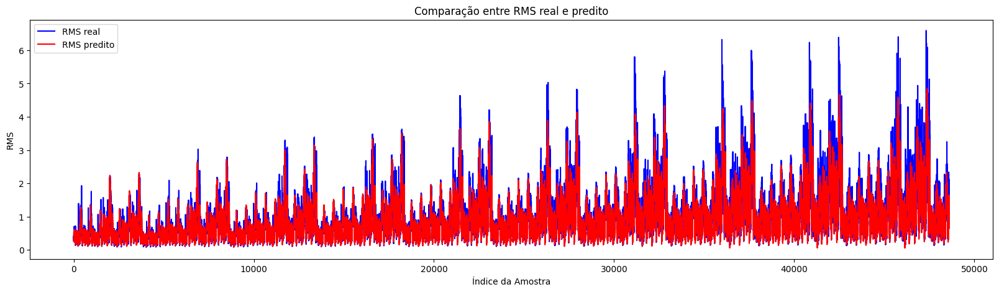

In [ ]:
plt.figure(figsize=(20, 5))

plt.plot(range(len(y)), y, label='RMS real', color='blue')
plt.plot(range(len(y_pred)), y_pred, label='RMS predito', color='red')
plt.legend()
plt.xlabel('Índice da Amostra')
plt.ylabel('RMS')
plt.title('Comparação entre RMS real e predito')
plt.show()

#A-HB

In [ ]:
print(df_A_HB)

In [ ]:
y_A_HB = df_A_HB.iloc[:, 0]

X_A_HB = df_A_HB.iloc[:, 1:8]

y_pred_A_HB = modelo.predict(X_A_HB)

In [ ]:
print(X_A_HB)

## Variações K

### -10%

In [ ]:
X_A_HB_k_menos_10 = X_A_HB.copy()

X_A_HB_k_menos_10['k'] = 0.014806

In [ ]:
print(X_A_HB_k_menos_10)

In [ ]:
y_pred_A_HB_k_menos_10 = modelo.predict(X_A_HB_k_menos_10)

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    #plt.plot(range(inicio, fim), y_pred_A_HB_k_menos_10[inicio:fim], label='RMS k alterado em menos 10%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')


### -20%

In [ ]:
X_A_HB_k_menos_20 = X_A_HB.copy()

X_A_HB_k_menos_20['k'] = 0.007403

In [ ]:
print(X_A_HB_k_menos_20)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.007403  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.007403  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.007403  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_menos_20 = modelo.predict(X_A_HB_k_menos_20)

169/169 [==============================] - 0s 1ms/step


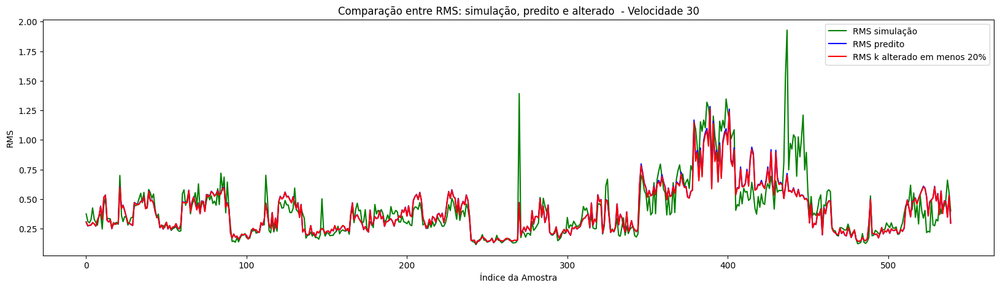

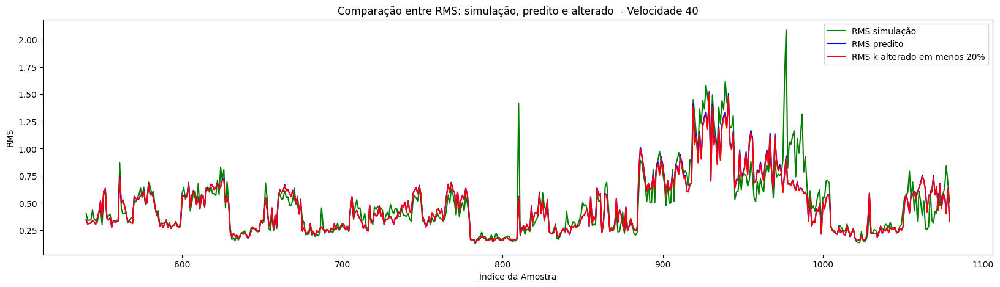

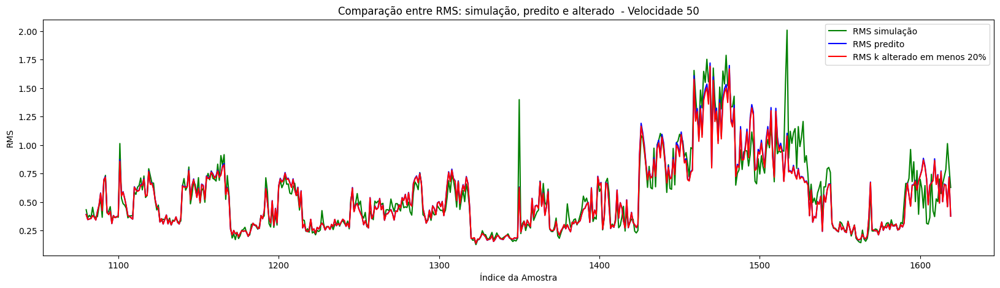

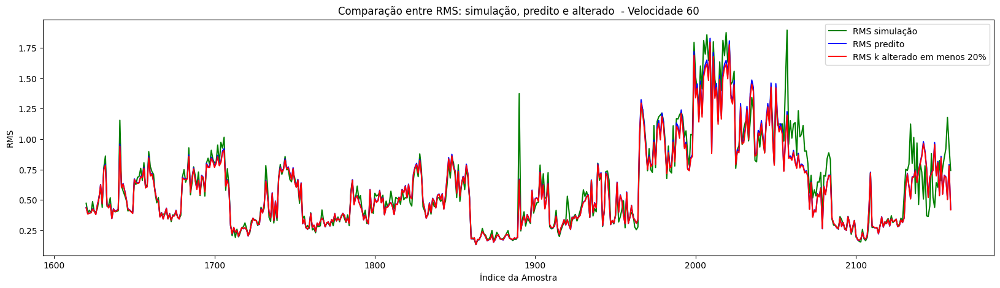

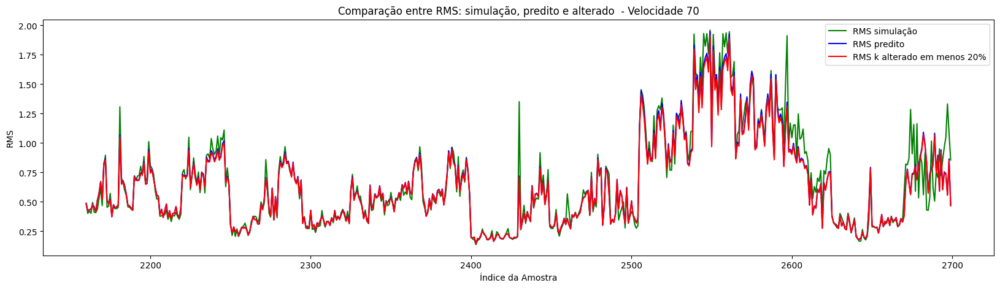

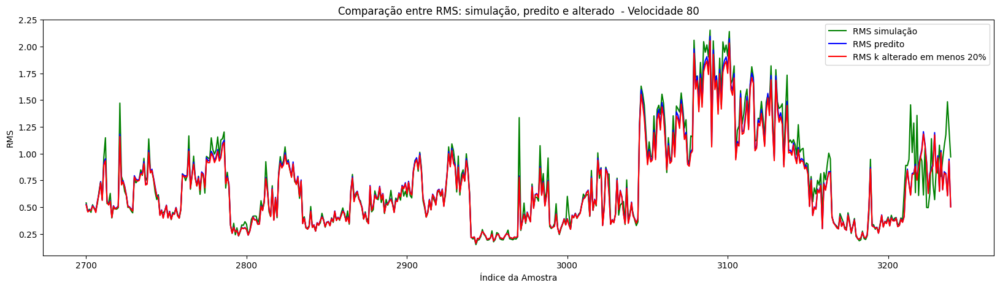

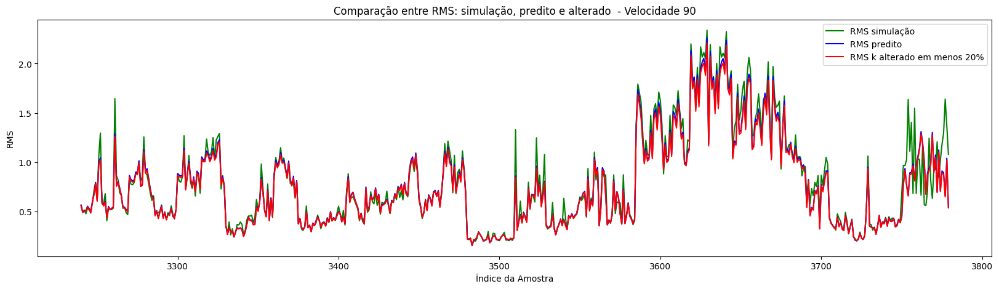

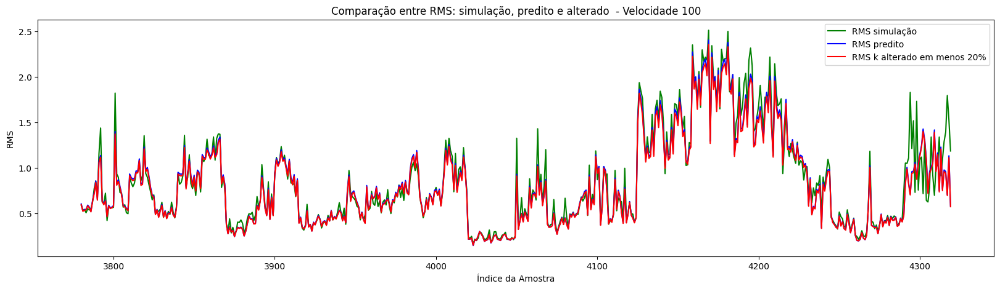

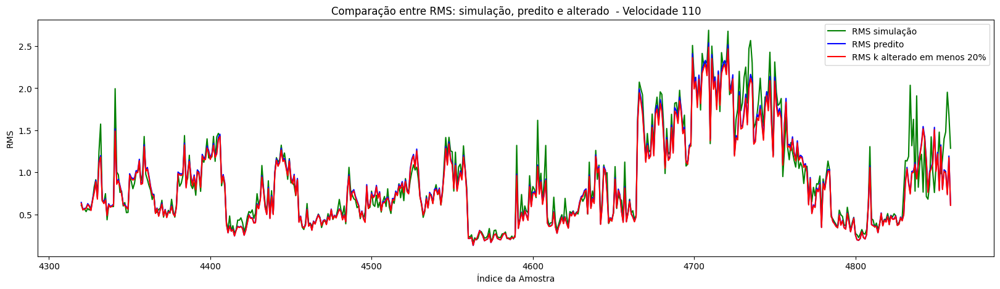

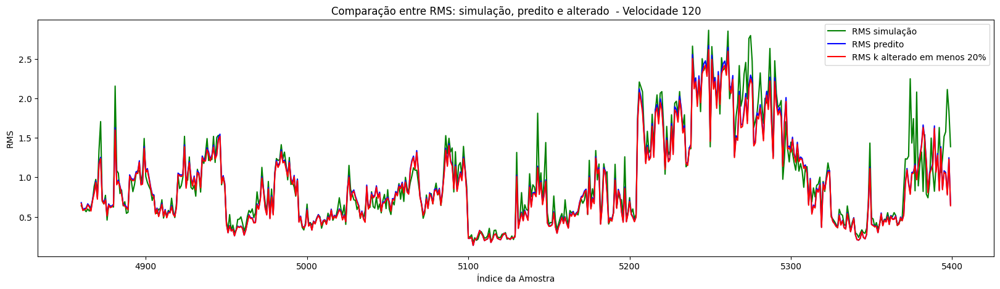

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_menos_20[inicio:fim], label='RMS k alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')


### -30%

In [ ]:
X_A_HB_k_menos_30 = X_A_HB.copy()

X_A_HB_k_menos_30['k'] = 0

In [ ]:
print(X_A_HB_k_menos_30)

            IRI    V  k         c        ms       mus       kus
0      0.175070  0.0  0  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0  0.103632  0.121332  0.123328  0.377358
...         ...  ... ..       ...       ...       ...       ...
44275  0.325042  1.0  0  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_menos_30 = modelo.predict(X_A_HB_k_menos_30)

169/169 [==============================] - 0s 1ms/step


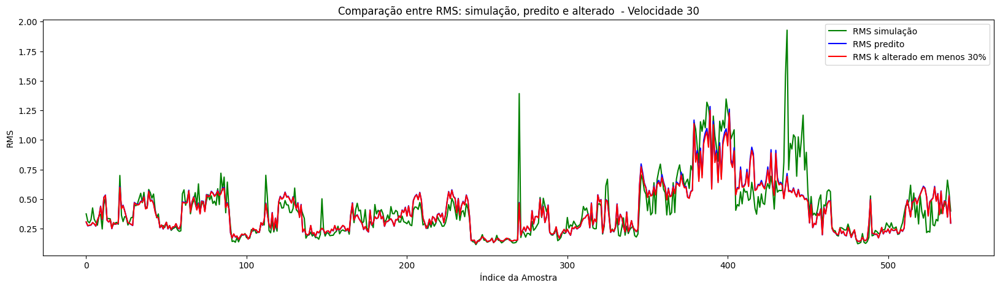

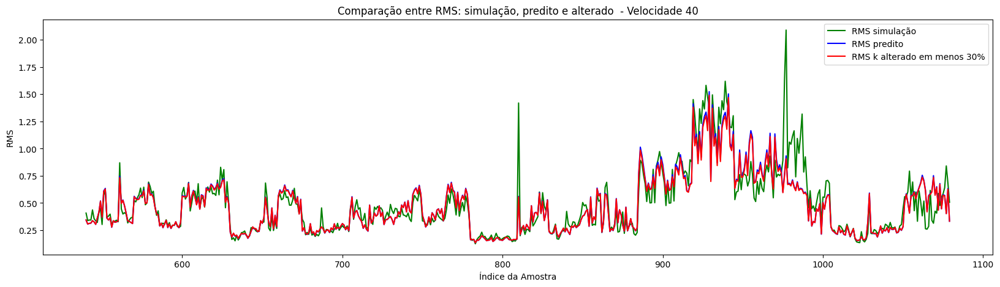

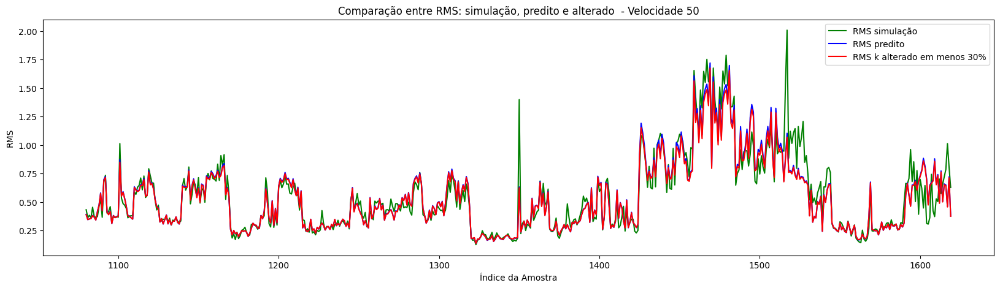

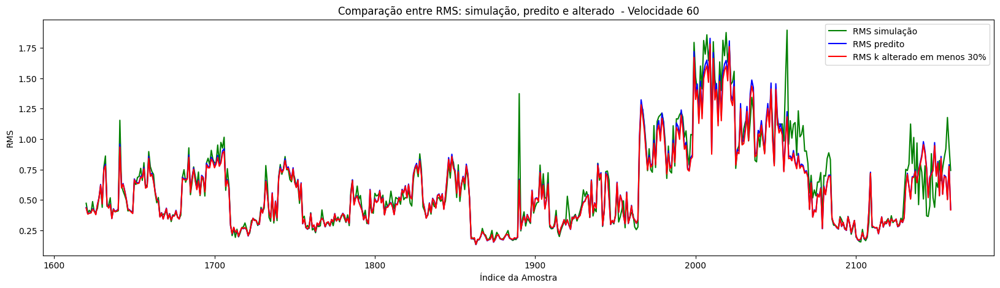

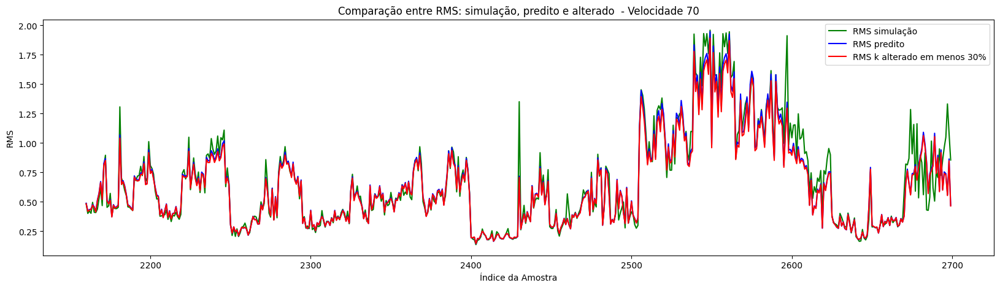

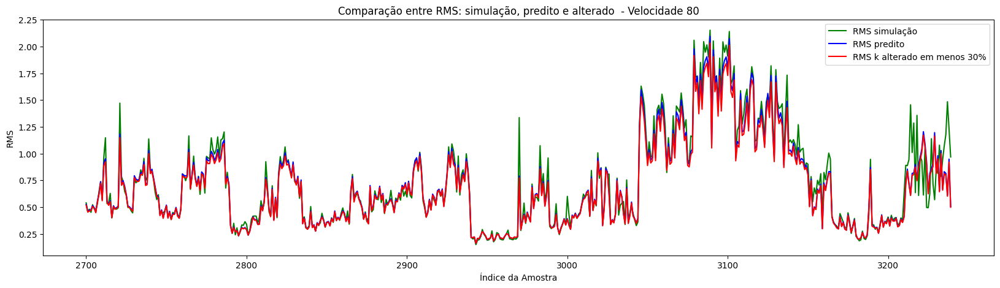

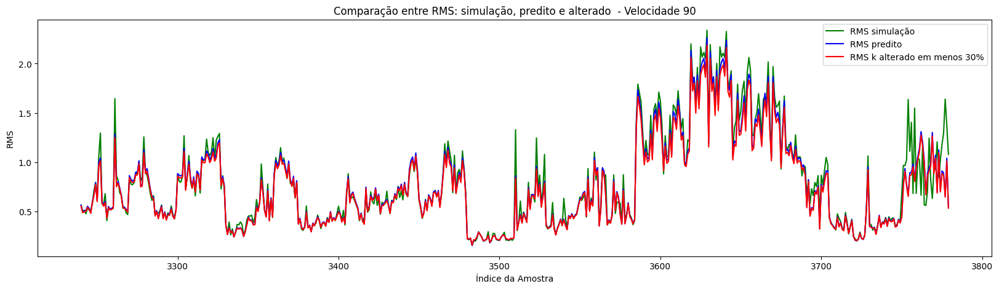

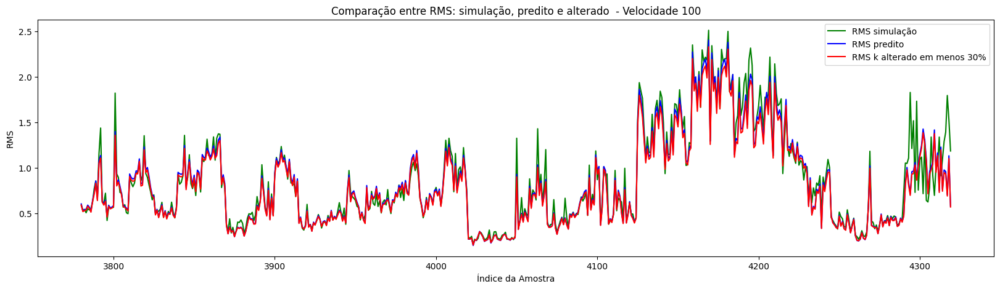

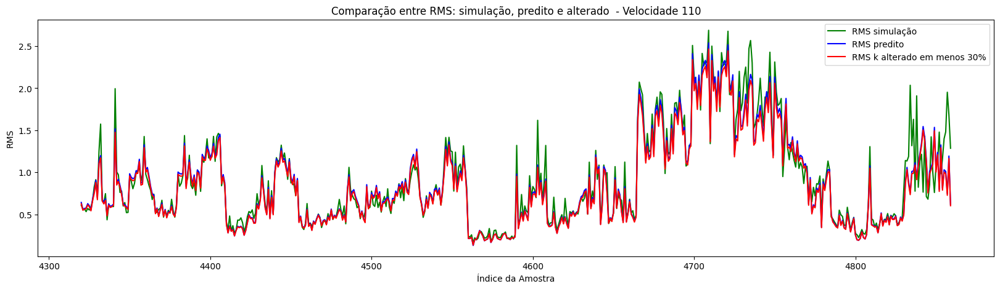

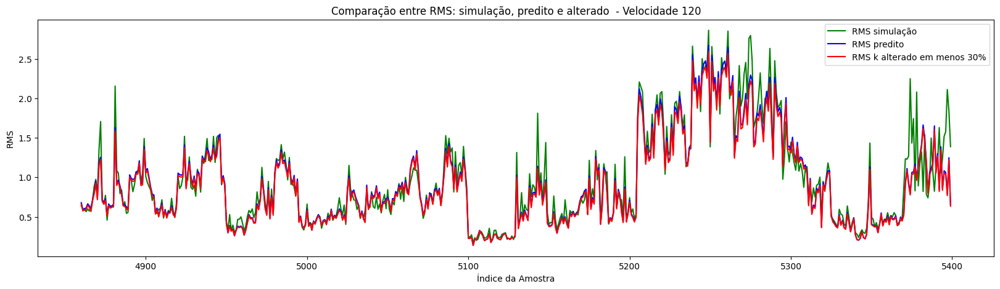

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_menos_30[inicio:fim], label='RMS k alterado em menos 30%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')


### +10%

In [ ]:
X_A_HB_k_mais_10 = X_A_HB.copy()

X_A_HB_k_mais_10['k'] = 0.029613

In [ ]:
print(X_A_HB_k_mais_10)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.029613  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.029613  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.029613  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_mais_10 = modelo.predict(X_A_HB_k_mais_10)

169/169 [==============================] - 0s 2ms/step


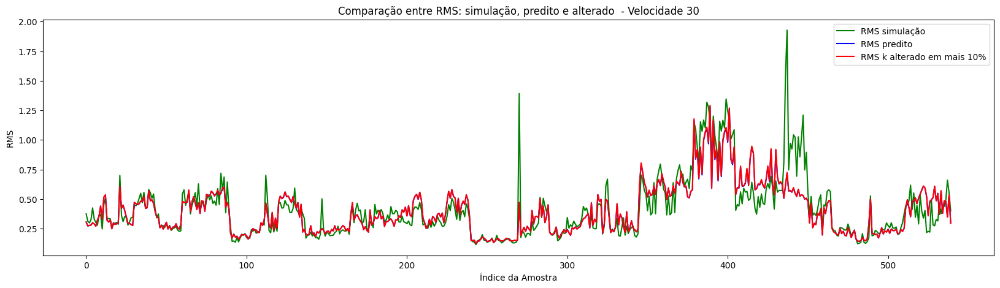

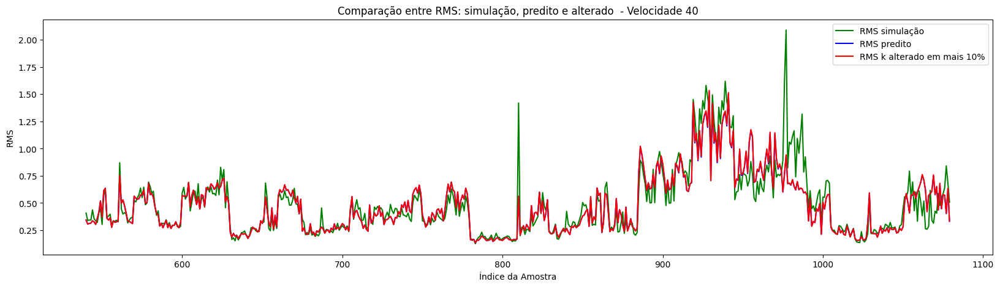

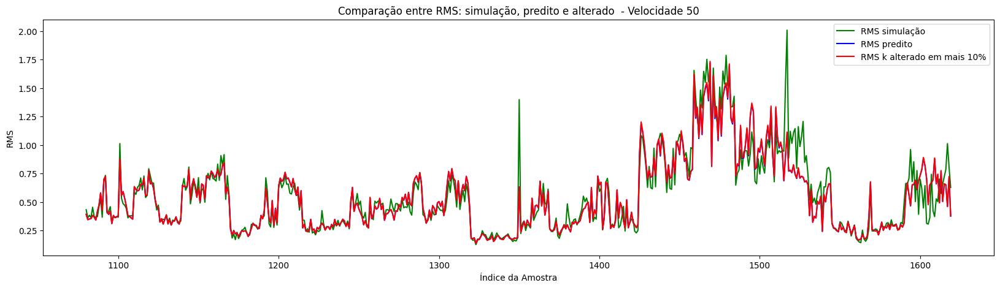

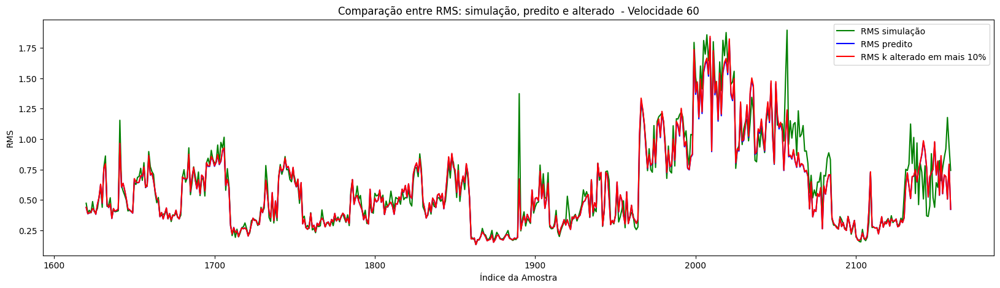

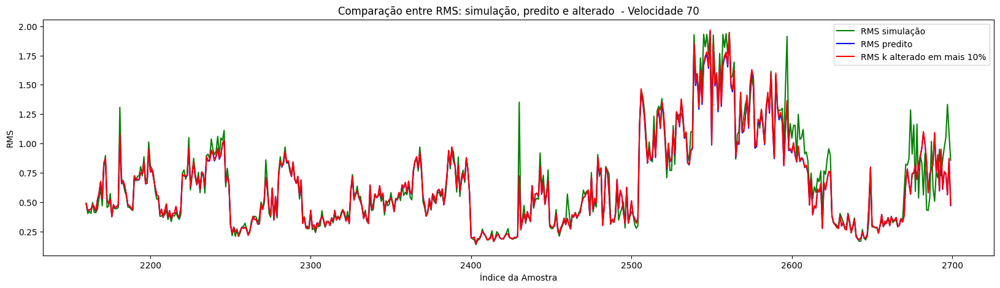

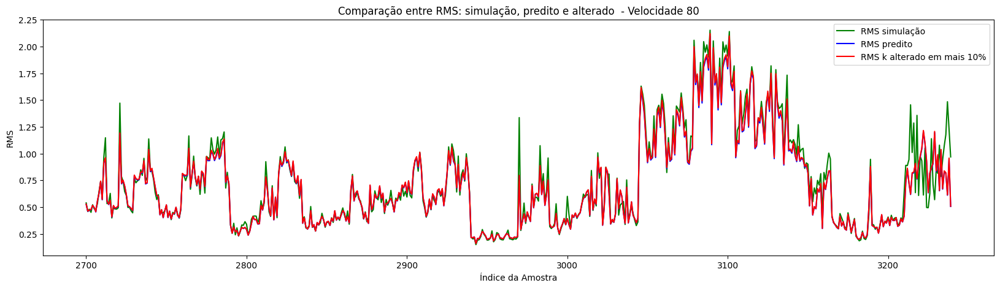

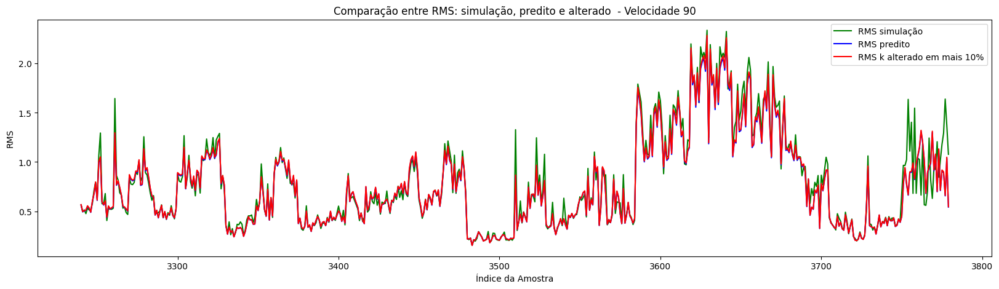

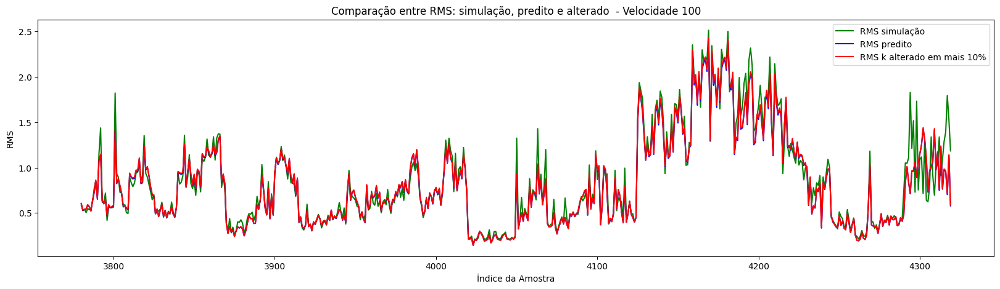

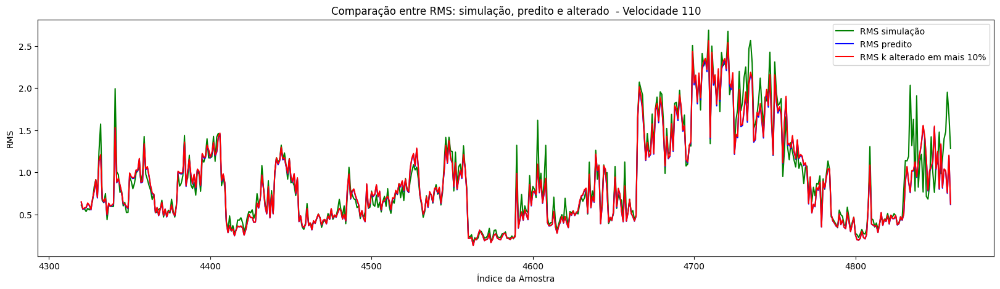

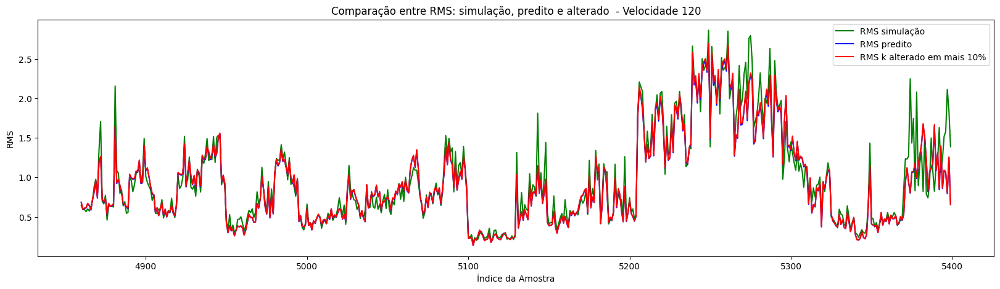

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_mais_10[inicio:fim], label='RMS k alterado em mais 10%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +20%

In [ ]:
X_A_HB_k_mais_20 = X_A_HB.copy()

X_A_HB_k_mais_20['k'] = 0.037017

In [ ]:
print(X_A_HB_k_mais_20)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.037017  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_mais_20 = modelo.predict(X_A_HB_k_mais_20)

169/169 [==============================] - 0s 3ms/step


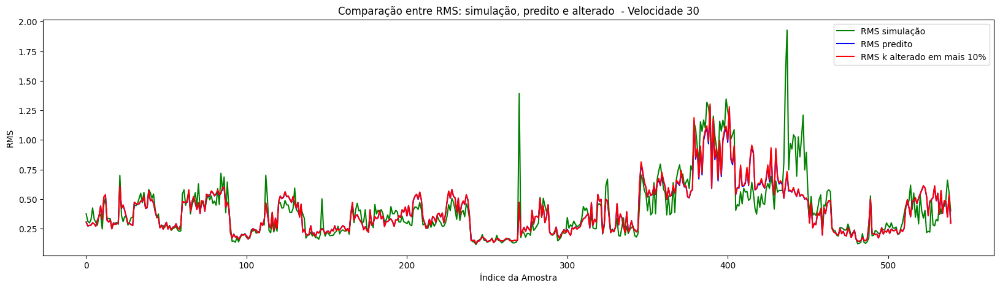

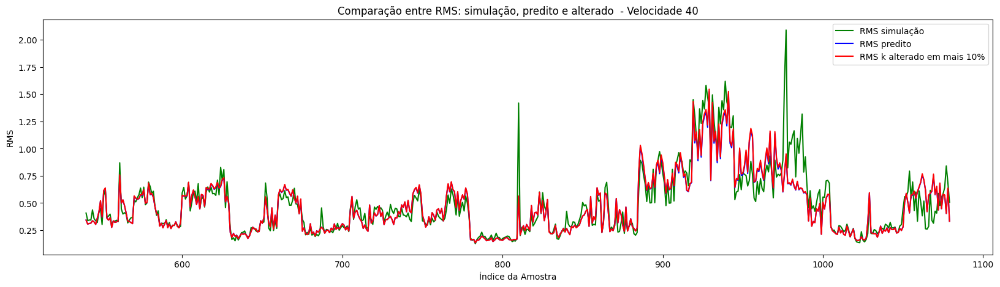

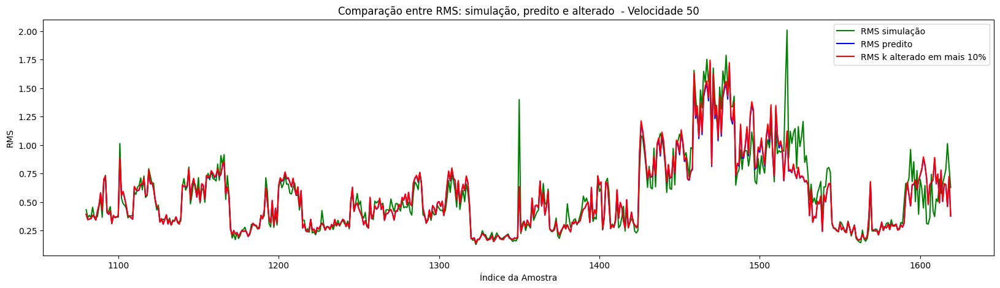

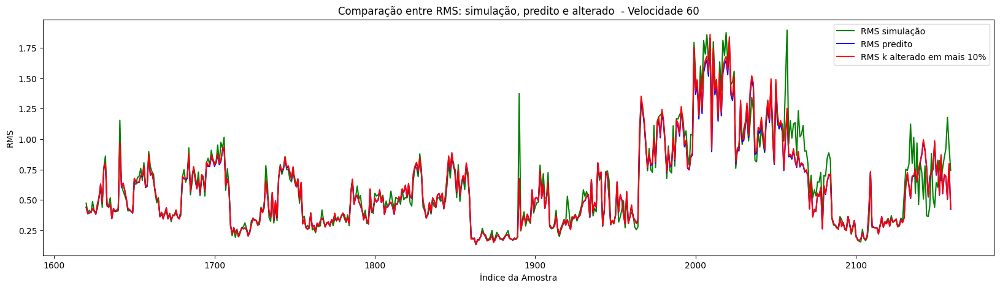

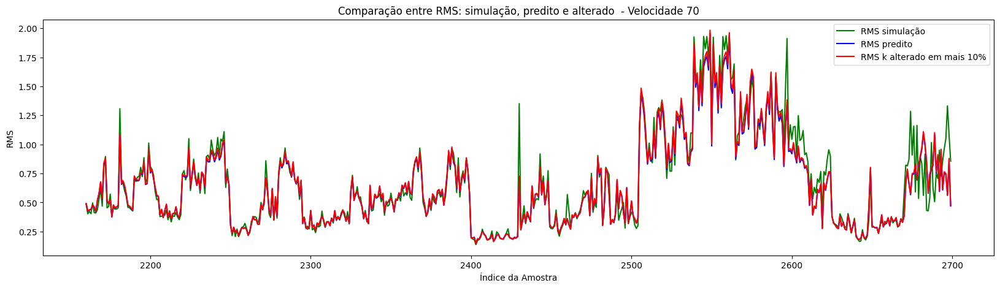

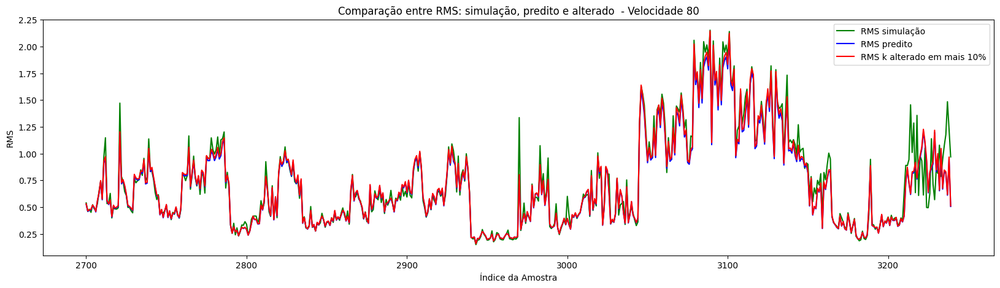

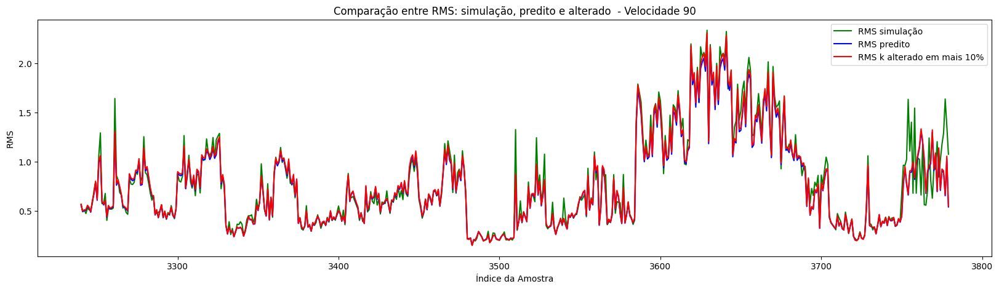

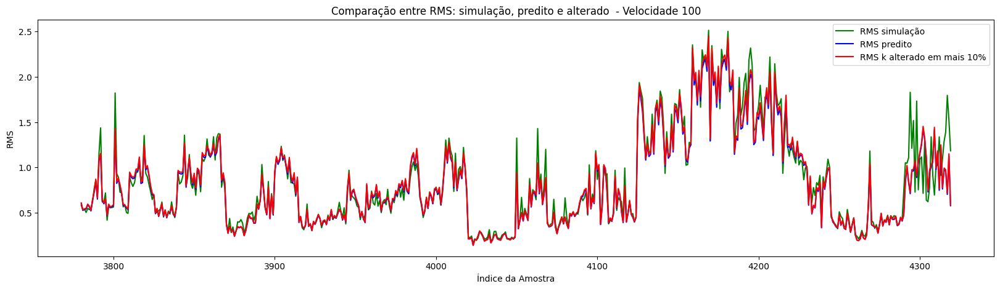

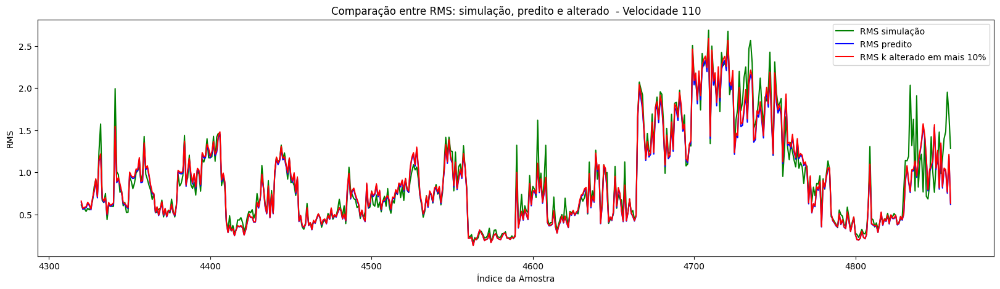

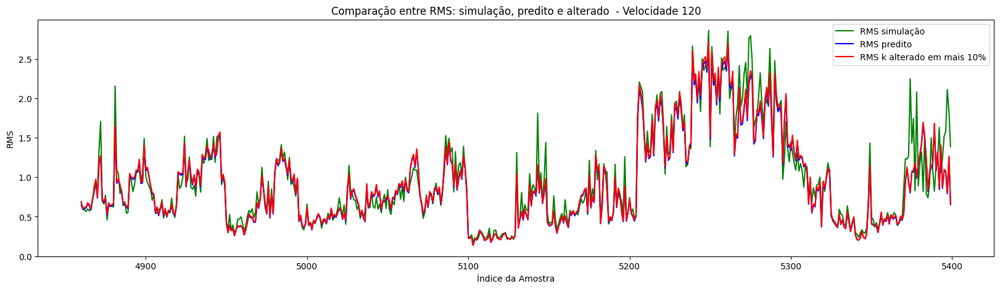

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_mais_20[inicio:fim], label='RMS k alterado em mais 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### +30%

In [ ]:
X_A_HB_k_mais_30 = X_A_HB.copy()

X_A_HB_k_mais_30['k'] = 0.037017

In [ ]:
print(X_A_HB_k_mais_30)

            IRI    V         k         c        ms       mus       kus
0      0.175070  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
1      0.147721  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
2      0.151798  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
3      0.154031  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
4      0.170444  0.0  0.037017  0.103632  0.121332  0.123328  0.377358
...         ...  ...       ...       ...       ...       ...       ...
44275  0.325042  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.037017  0.103632  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.037017  0.103632  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_k_mais_30 = modelo.predict(X_A_HB_k_mais_30)

169/169 [==============================] - 0s 2ms/step


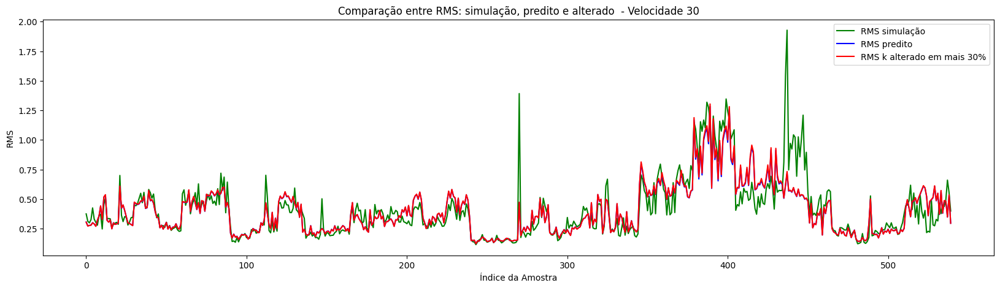

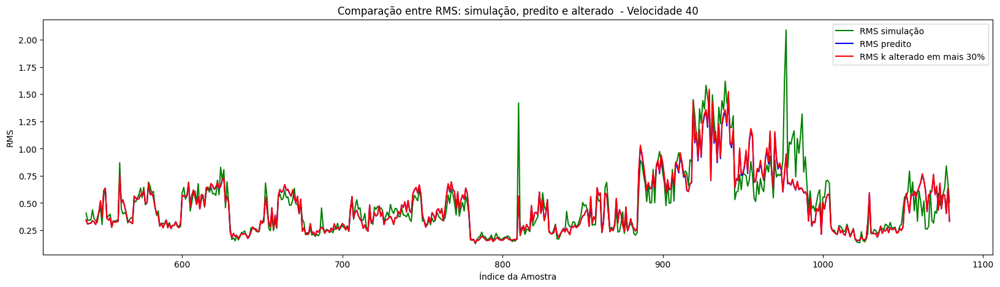

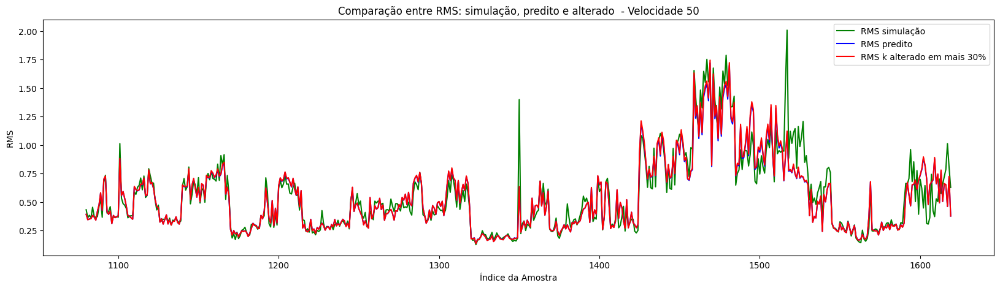

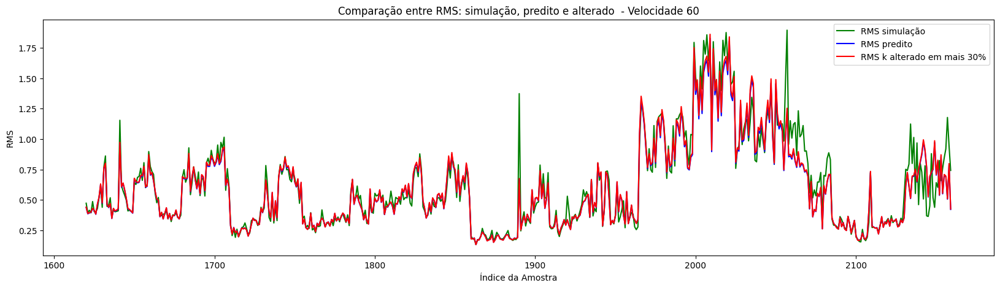

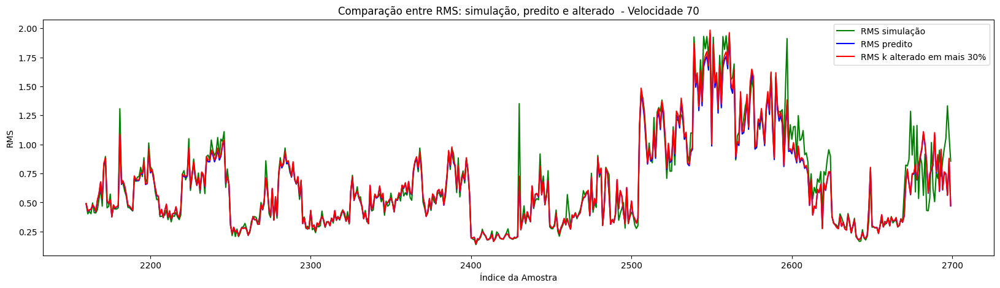

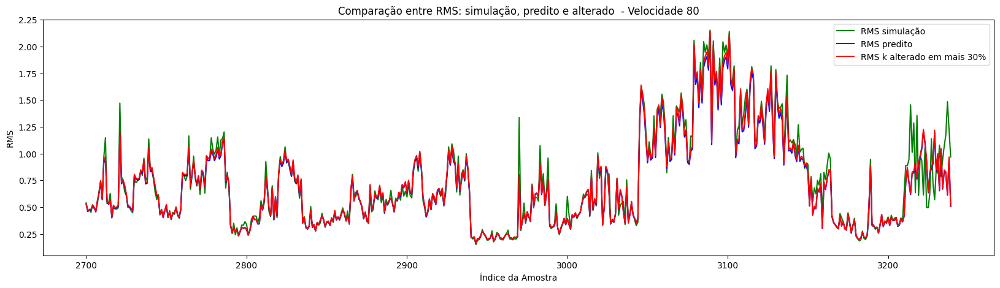

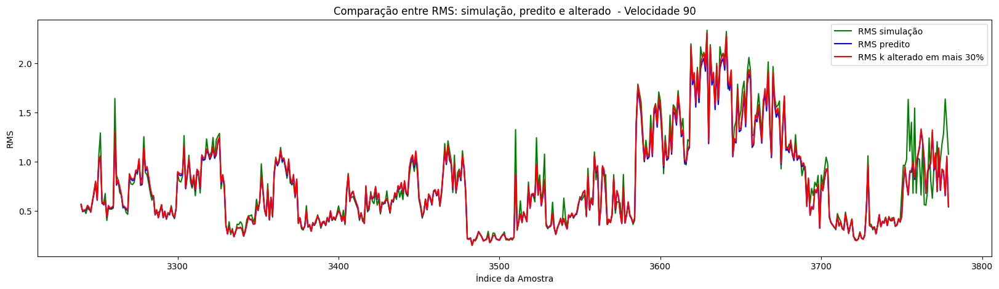

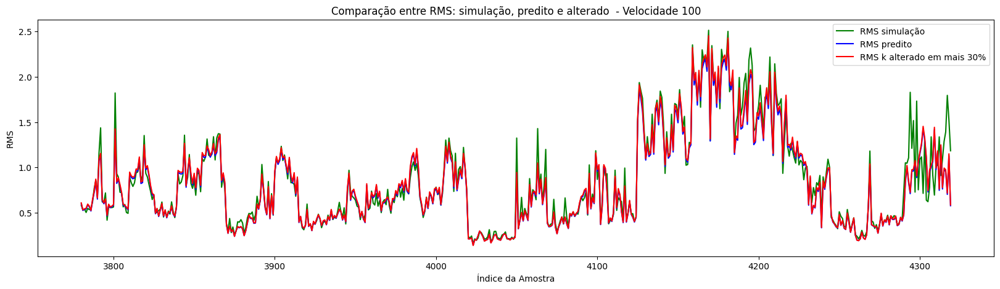

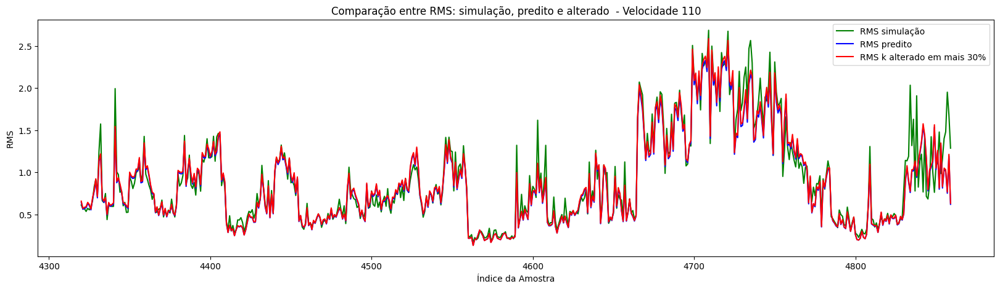

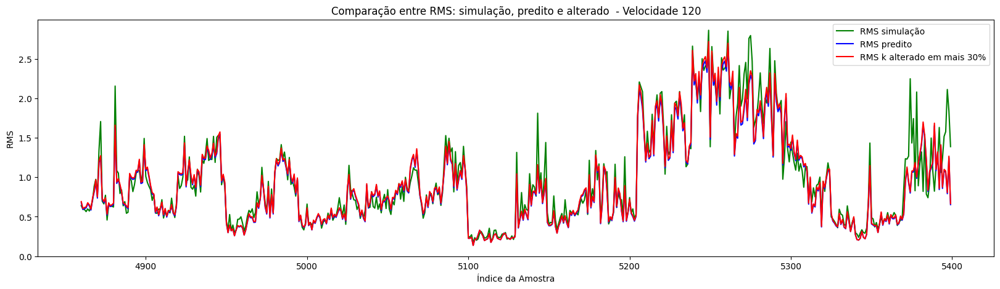

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_k_mais_30[inicio:fim], label='RMS k alterado em mais 30%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

## Variações c

### -10%

In [ ]:
X_A_HB_c_menos_10 = X_A_HB.copy()

X_A_HB_c_menos_10['c'] = 0.069026

In [ ]:
print(X_A_HB_c_menos_10)

            IRI    V        k         c        ms       mus       kus
0      0.175070  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
1      0.147721  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
2      0.151798  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
3      0.154031  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
4      0.170444  0.0  0.02221  0.069026  0.121332  0.123328  0.377358
...         ...  ...      ...       ...       ...       ...       ...
44275  0.325042  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.02221  0.069026  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.02221  0.069026  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_c_menos_10 = modelo.predict(X_A_HB_c_menos_10)

169/169 [==============================] - 0s 2ms/step


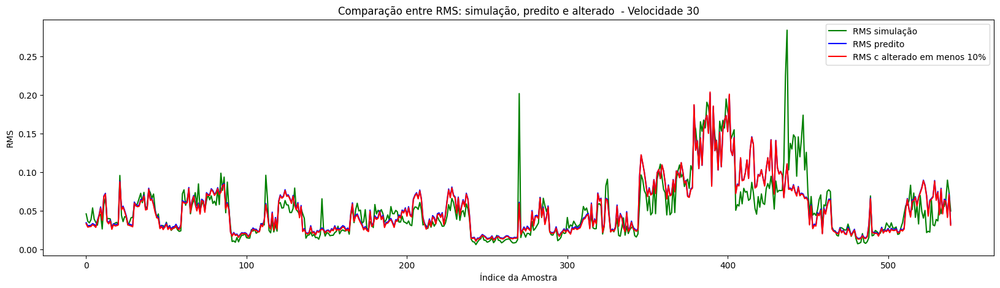

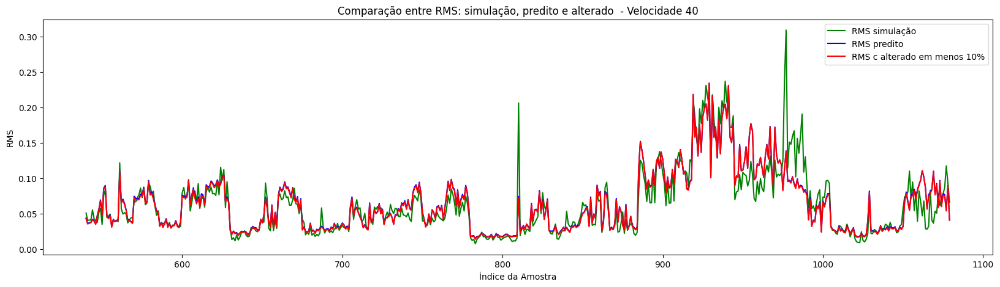

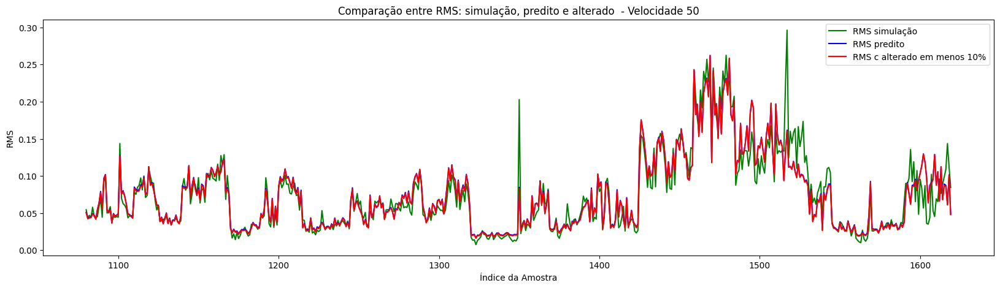

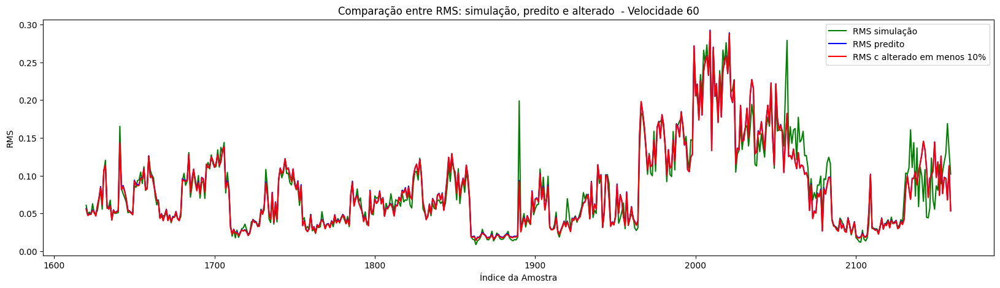

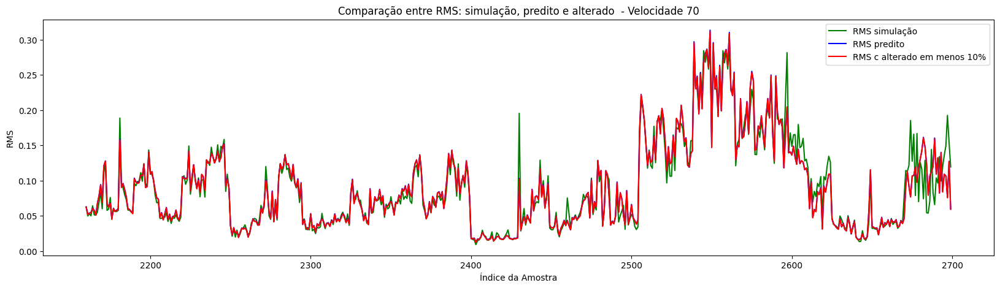

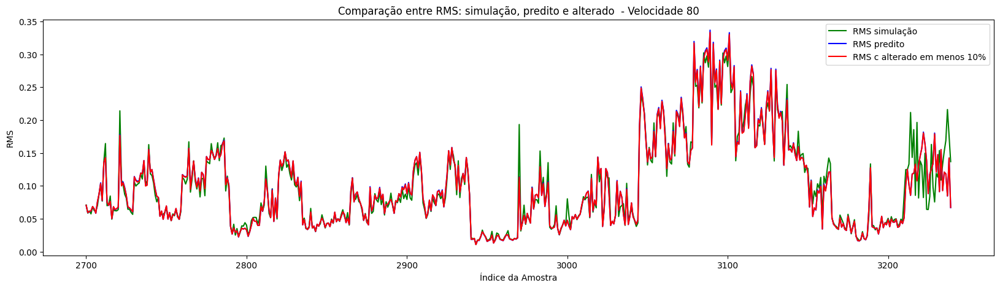

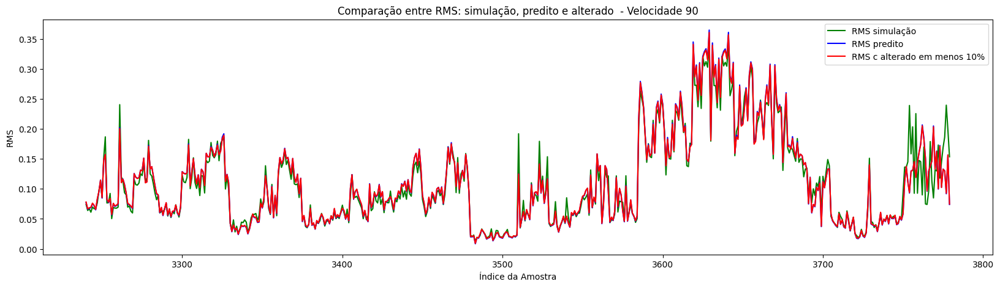

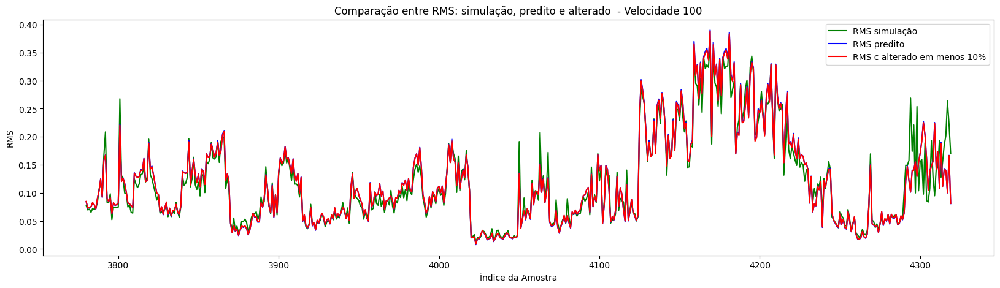

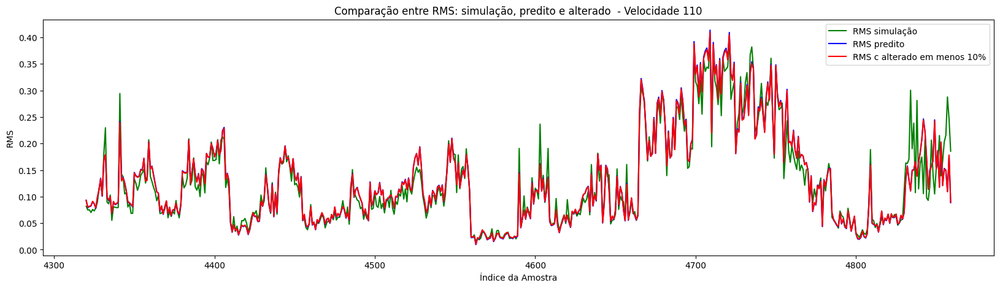

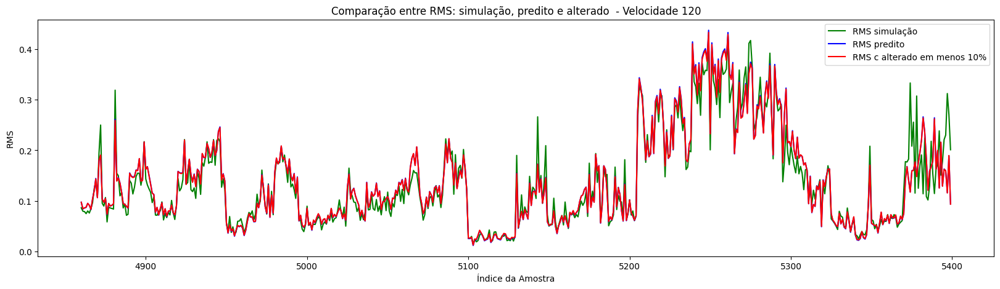

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_menos_10[inicio:fim], label='RMS c alterado em menos 10%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### -20%

In [ ]:
X_A_HB_c_menos_20 = X_A_HB.copy()

X_A_HB_c_menos_20['c'] = 0.034568

In [ ]:
print(X_A_HB_c_menos_20)

            IRI    V        k         c        ms       mus       kus
0      0.175070  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
1      0.147721  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
2      0.151798  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
3      0.154031  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
4      0.170444  0.0  0.02221  0.034568  0.121332  0.123328  0.377358
...         ...  ...      ...       ...       ...       ...       ...
44275  0.325042  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.02221  0.034568  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.02221  0.034568  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_c_menos_20 = modelo.predict(X_A_HB_c_menos_20)

169/169 [==============================] - 0s 2ms/step


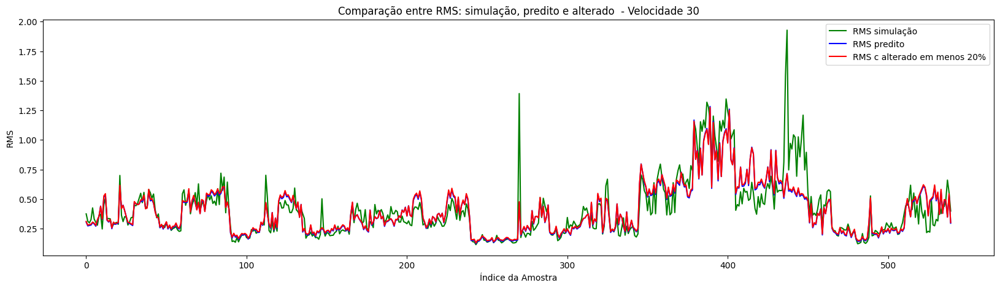

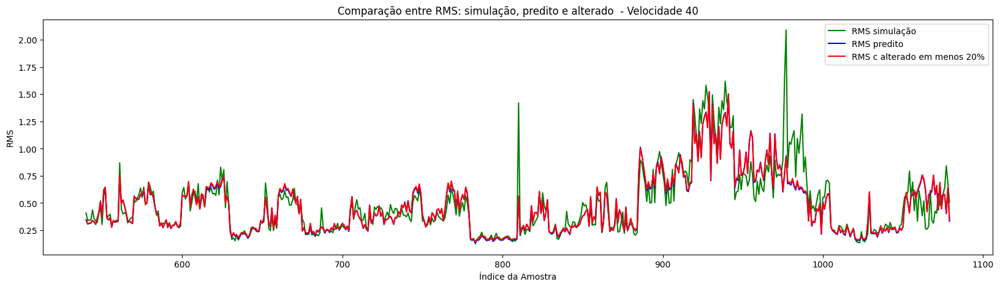

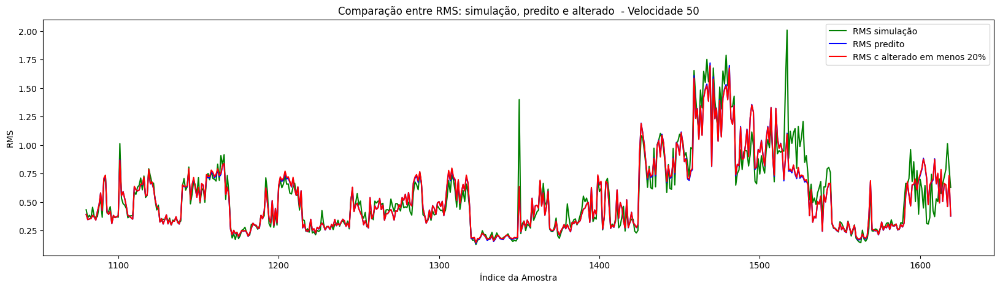

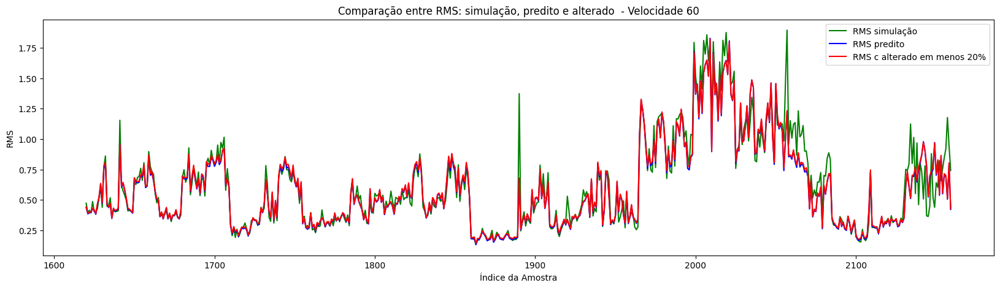

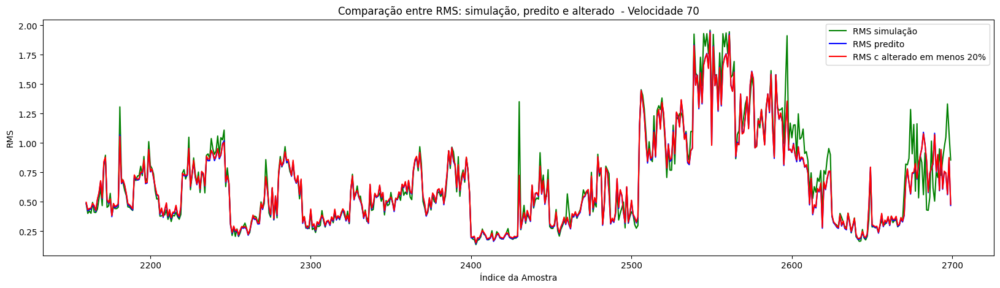

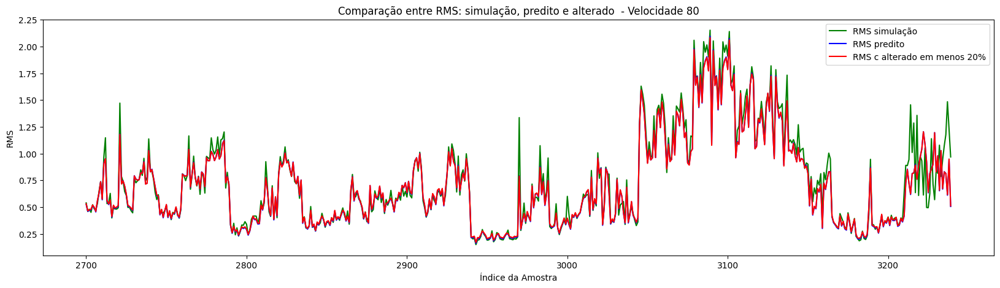

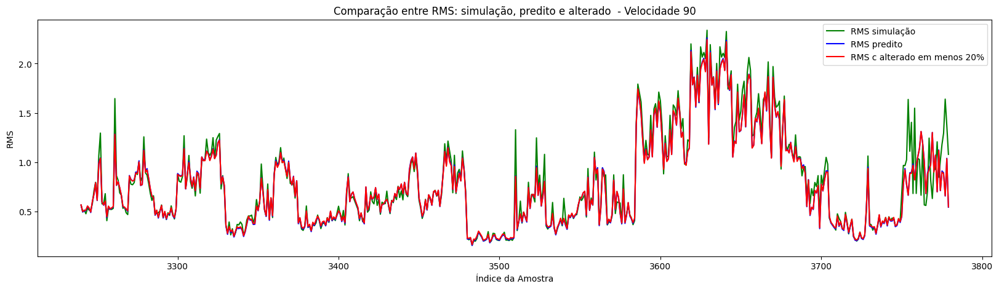

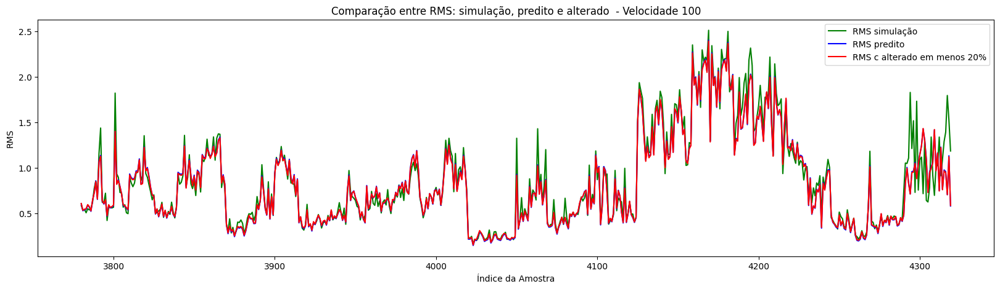

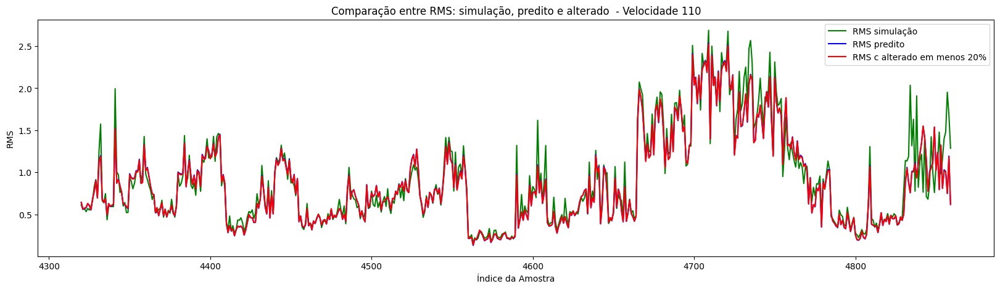

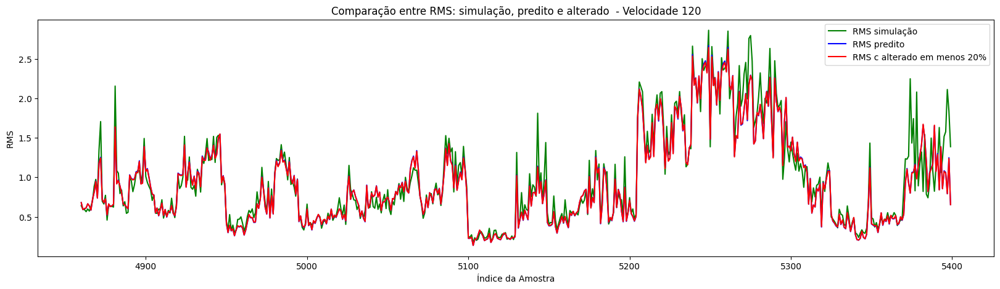

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_menos_20[inicio:fim], label='RMS c alterado em menos 20%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### -30%

In [ ]:
X_A_HB_c_menos_30 = X_A_HB.copy()

X_A_HB_c_menos_30['c'] = 0

In [ ]:
print(X_A_HB_c_menos_30)

            IRI    V        k  c        ms       mus       kus
0      0.175070  0.0  0.02221  0  0.121332  0.123328  0.377358
1      0.147721  0.0  0.02221  0  0.121332  0.123328  0.377358
2      0.151798  0.0  0.02221  0  0.121332  0.123328  0.377358
3      0.154031  0.0  0.02221  0  0.121332  0.123328  0.377358
4      0.170444  0.0  0.02221  0  0.121332  0.123328  0.377358
...         ...  ...      ... ..       ...       ...       ...
44275  0.325042  1.0  0.02221  0  0.121332  0.123328  0.377358
44276  0.316123  1.0  0.02221  0  0.121332  0.123328  0.377358
44277  0.210425  1.0  0.02221  0  0.121332  0.123328  0.377358
44278  0.402940  1.0  0.02221  0  0.121332  0.123328  0.377358
44279  0.167129  1.0  0.02221  0  0.121332  0.123328  0.377358

[5400 rows x 7 columns]


In [ ]:
y_pred_A_HB_c_menos_30 = modelo.predict(X_A_HB_c_menos_30)

169/169 [==============================] - 1s 3ms/step


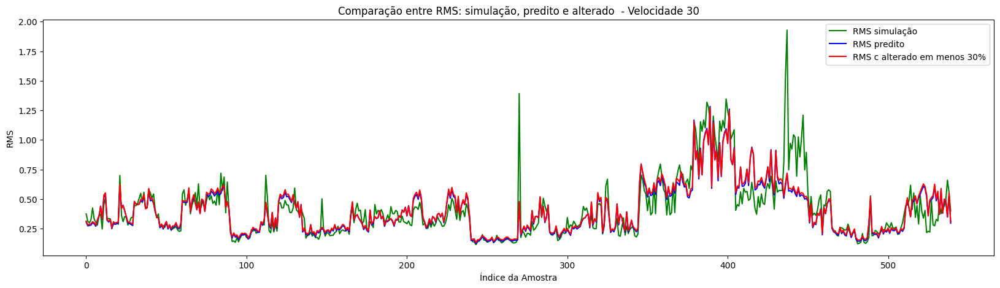

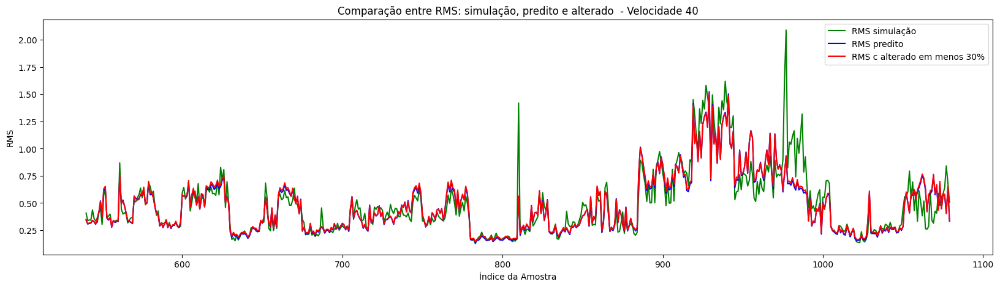

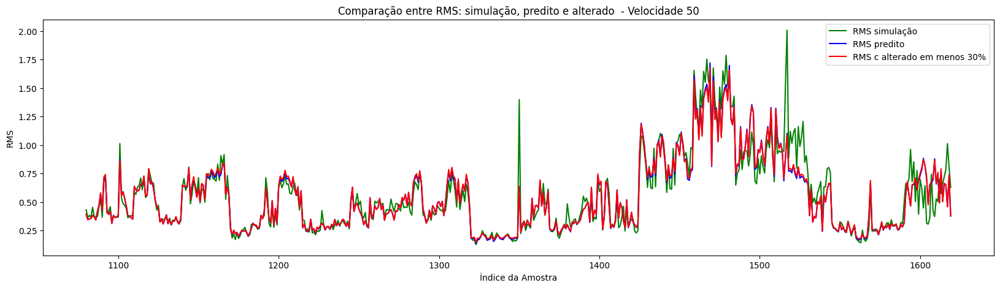

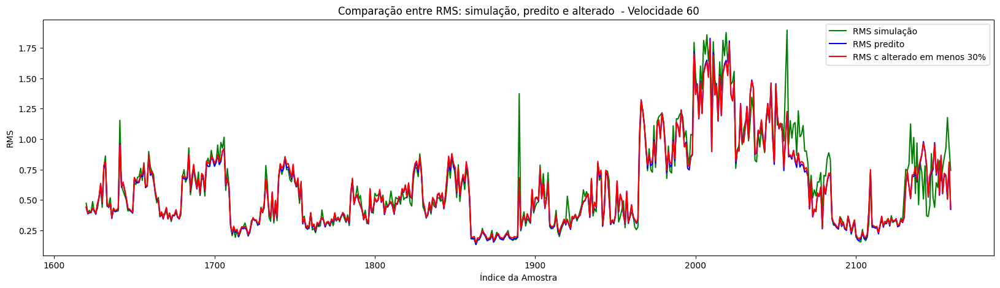

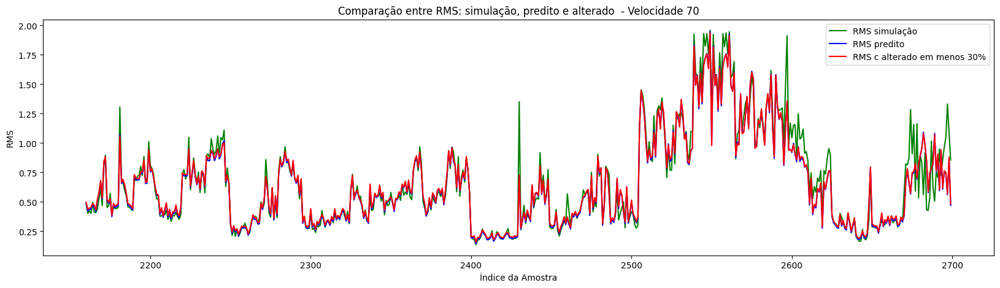

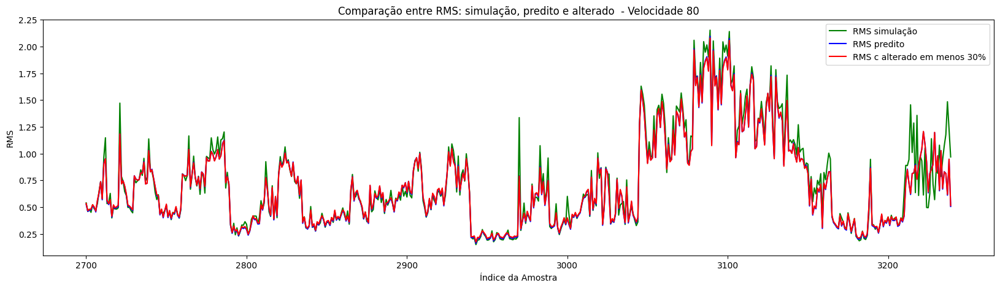

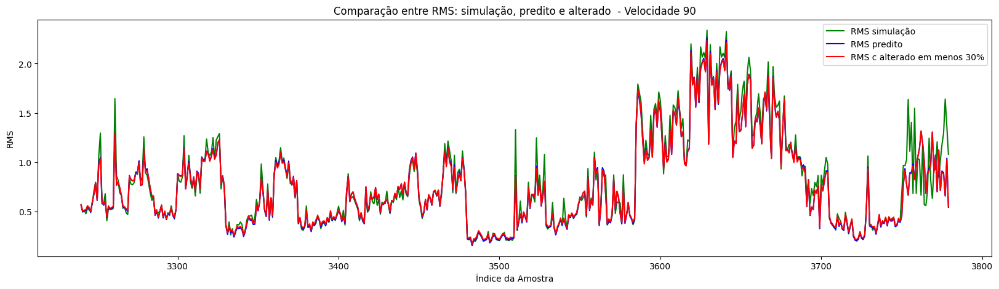

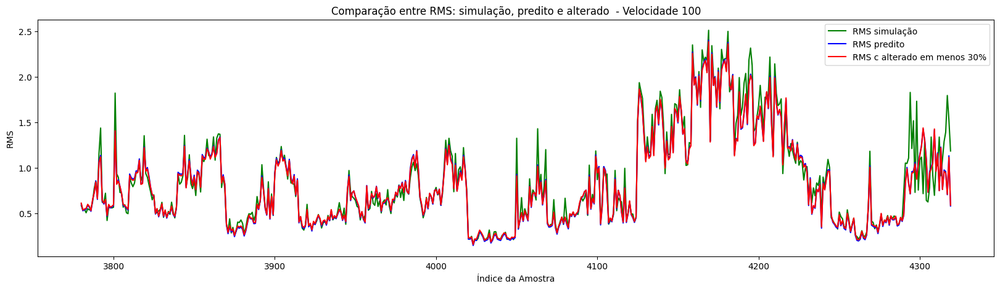

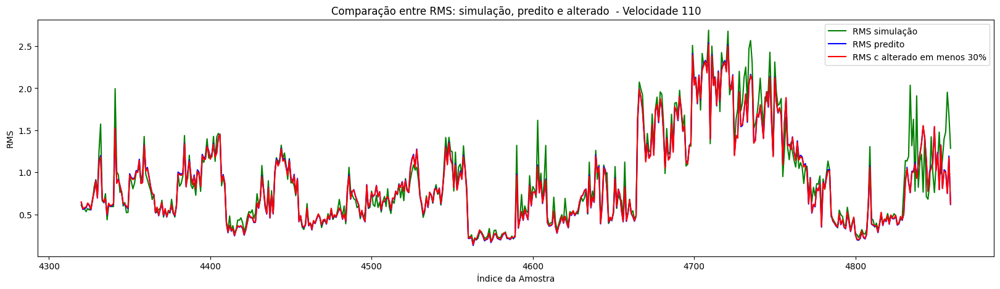

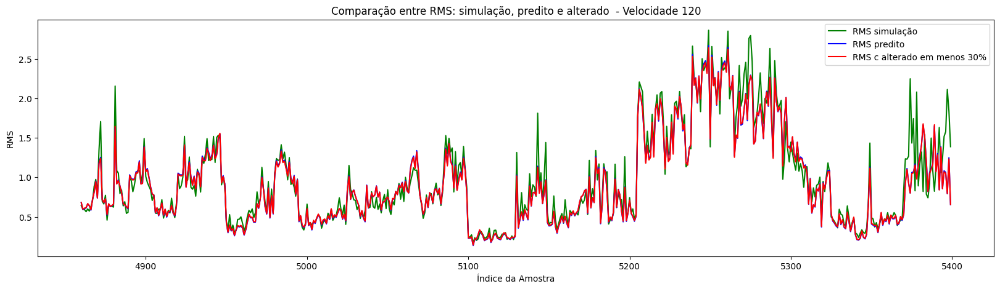

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.plot(range(inicio, fim), y_pred_A_HB_c_menos_30[inicio:fim], label='RMS c alterado em menos 30%', color='red')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

## Grafico todos os veiculos

### A-HB

In [ ]:
y_A_HB = df_A_HB.iloc[:, 0]

X_A_HB = df_A_HB.iloc[:, 1:8]

y_pred_A_HB = model.predict(X_A_HB)

169/169 [==============================] - 0s 2ms/step


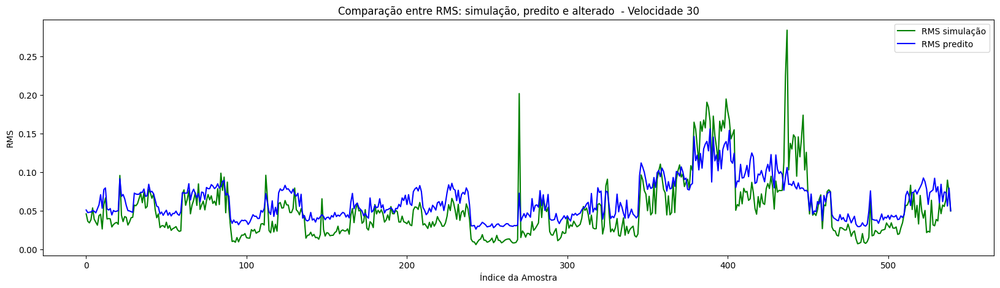

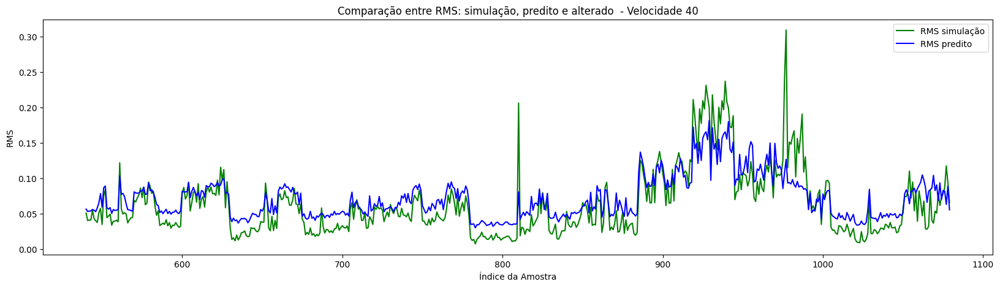

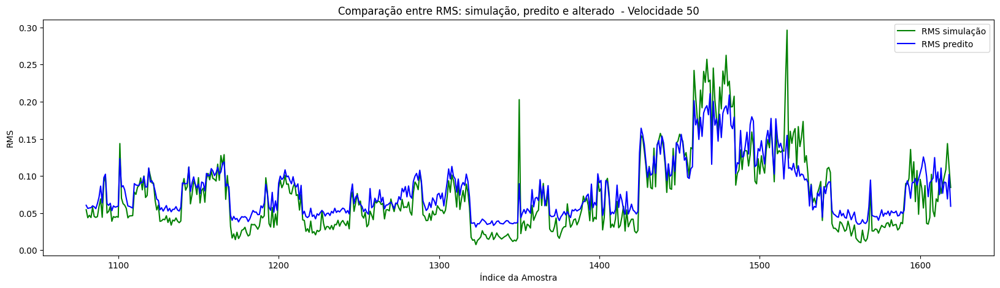

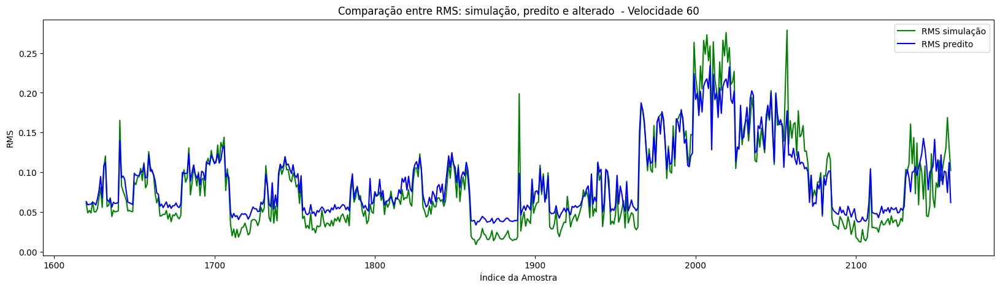

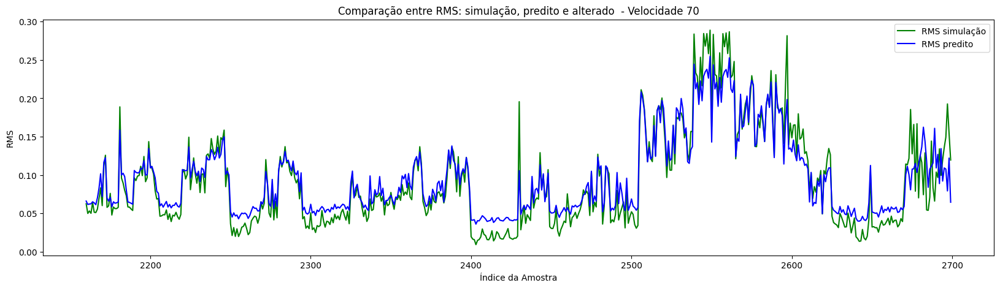

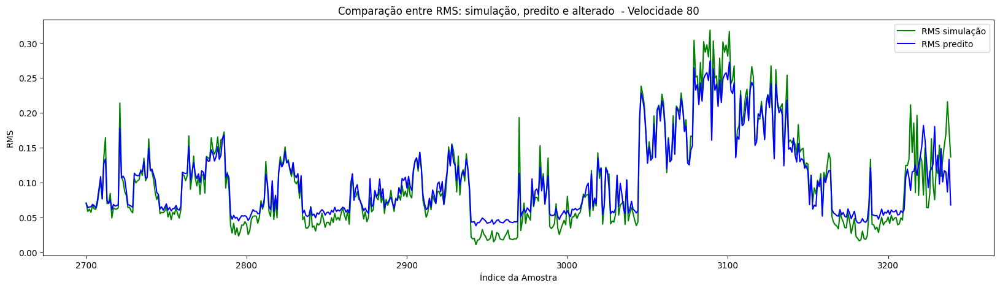

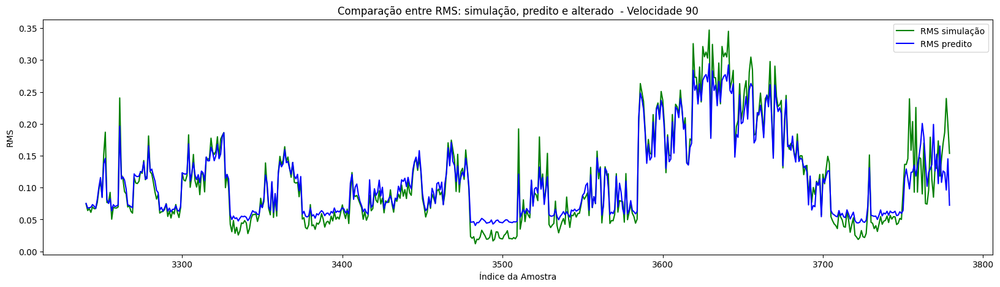

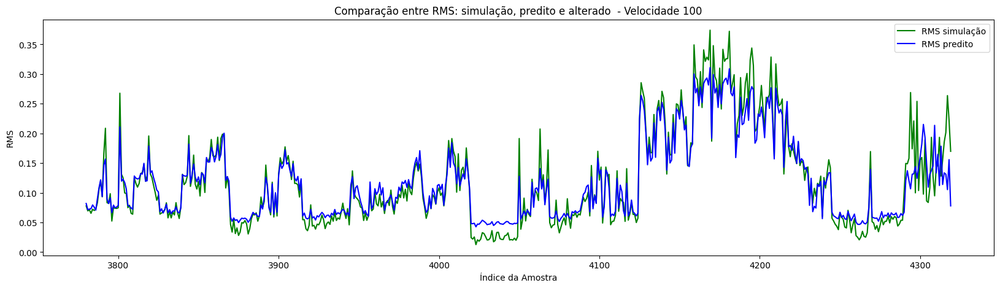

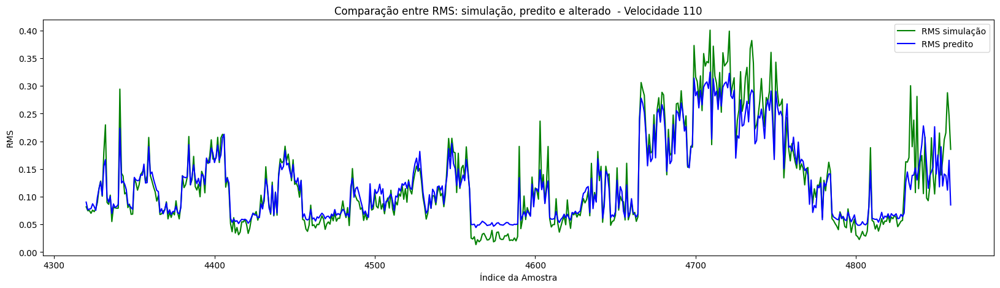

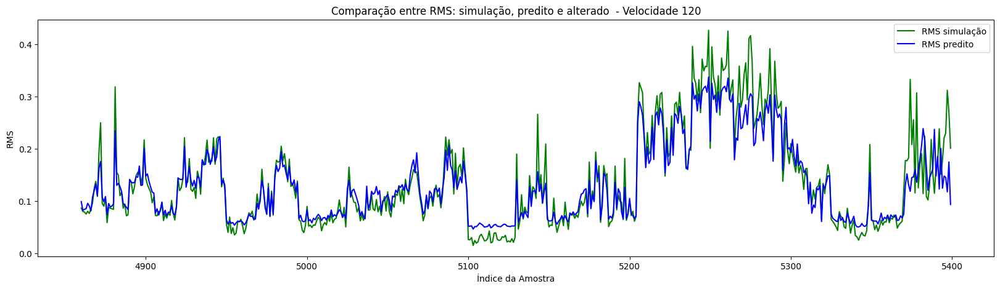

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_A_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_A_HB[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### B-HB

In [ ]:
y_B_HB = df_B_HB.iloc[:, 0]

X_B_HB = df_B_HB.iloc[:, 1:8]

y_pred_B_HB = model.predict(X_B_HB)

169/169 [==============================] - 0s 2ms/step


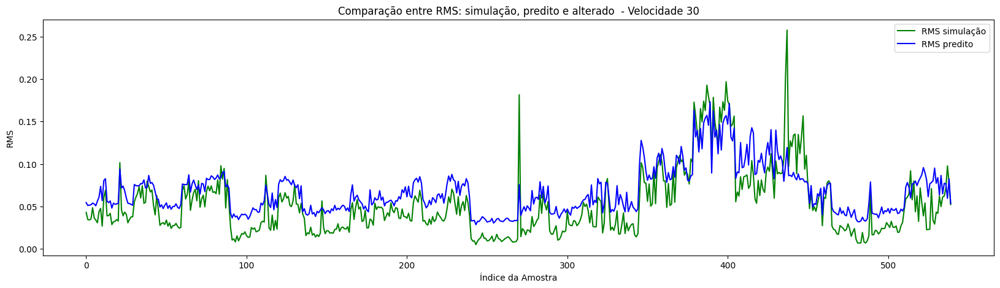

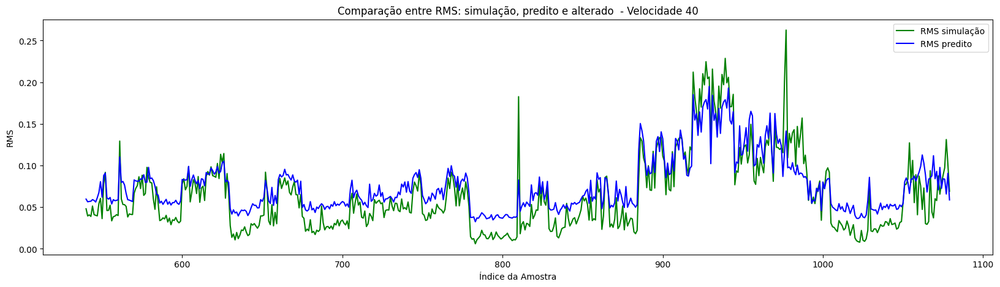

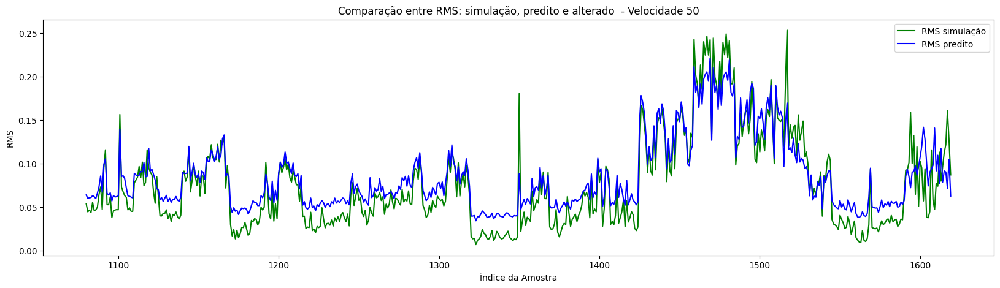

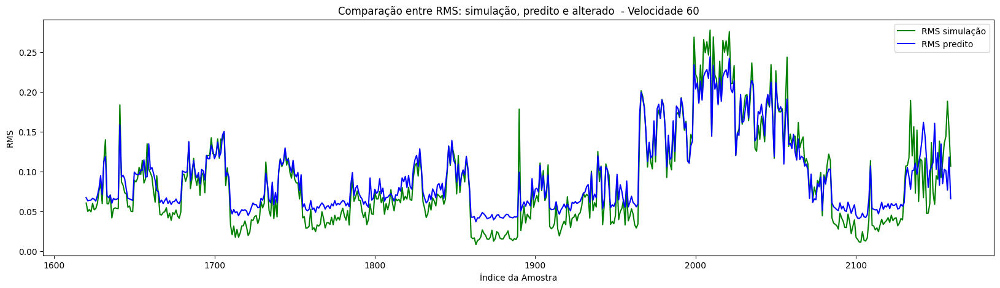

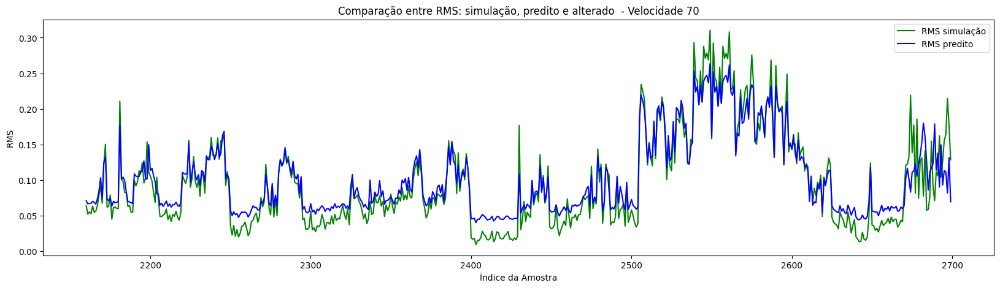

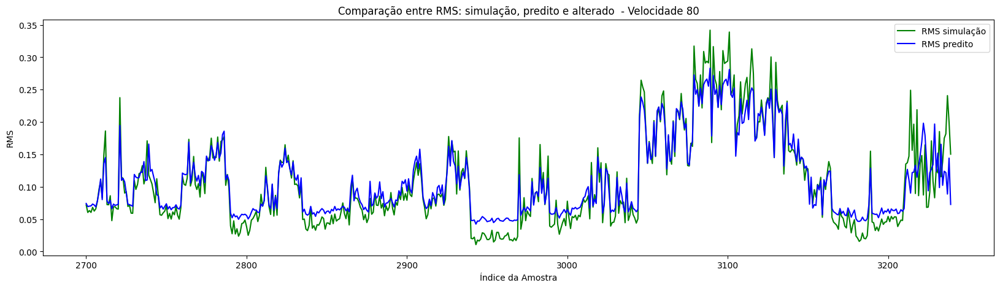

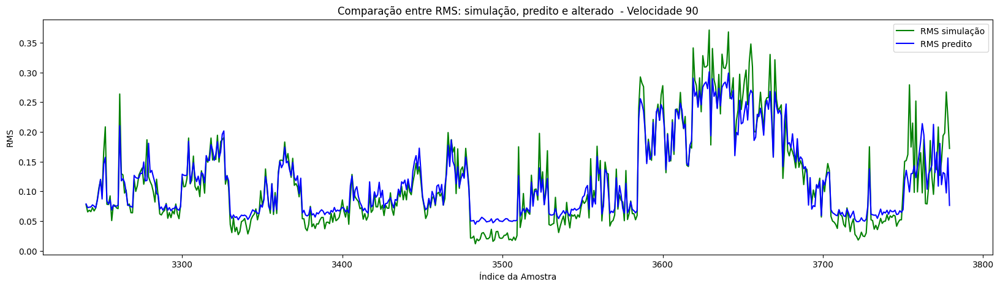

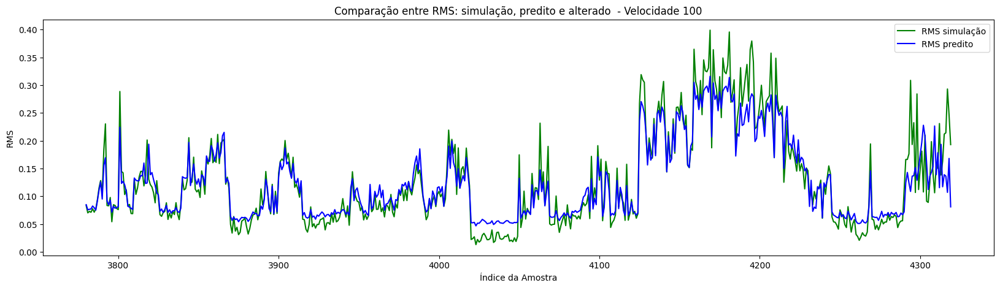

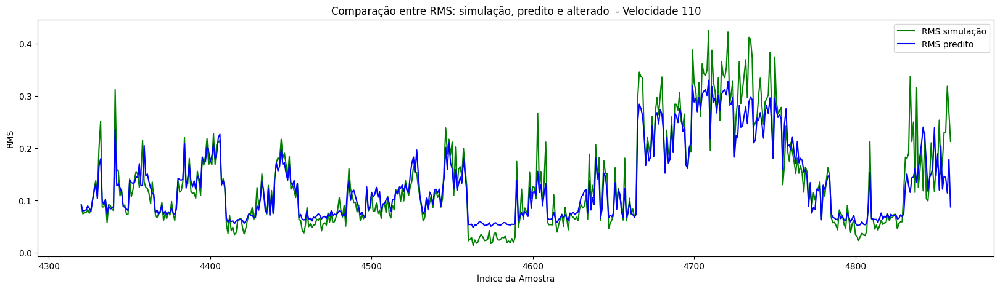

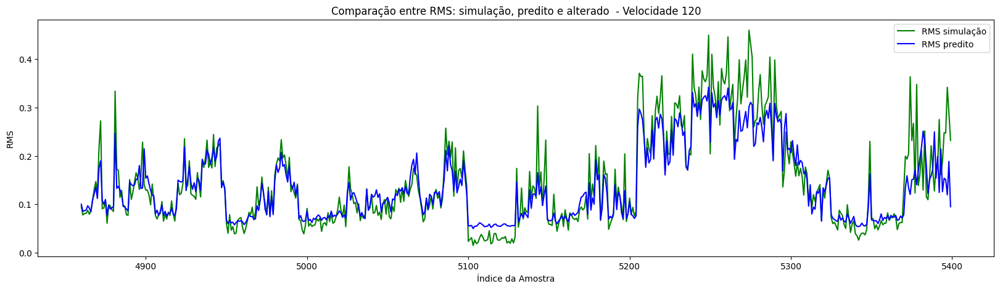

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_B_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_B_HB[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### C-HB

In [ ]:
y_C_HB = df_C_HB.iloc[:, 0]

X_C_HB = df_C_HB.iloc[:, 1:8]

y_pred_C_HB = model.predict(X_C_HB)

169/169 [==============================] - 1s 3ms/step


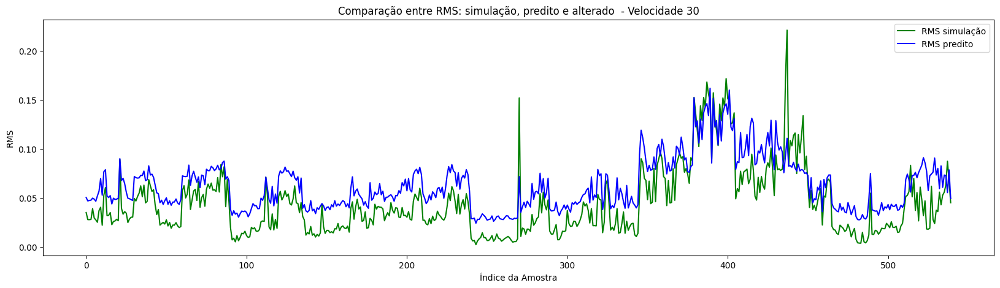

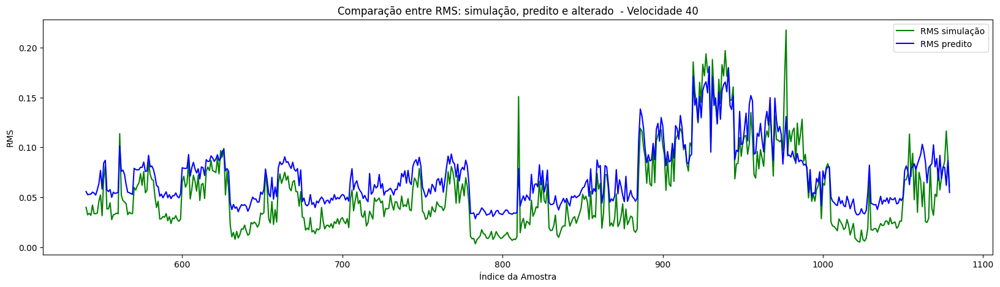

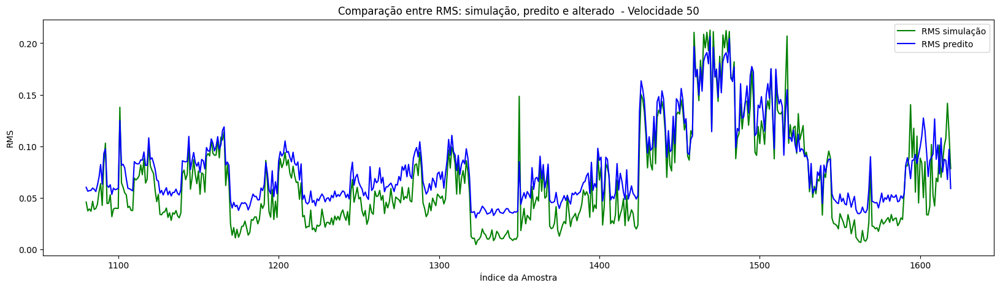

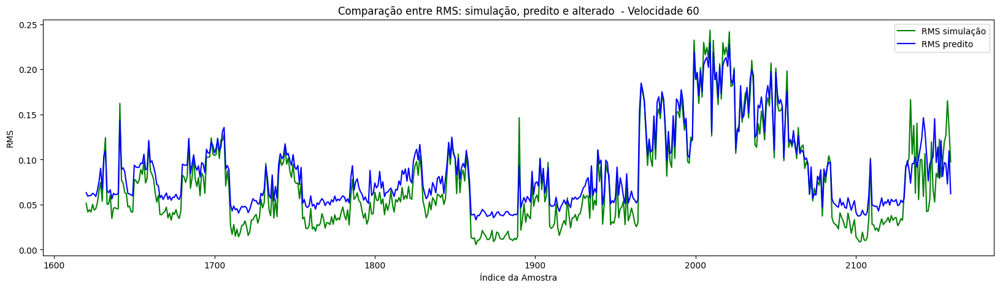

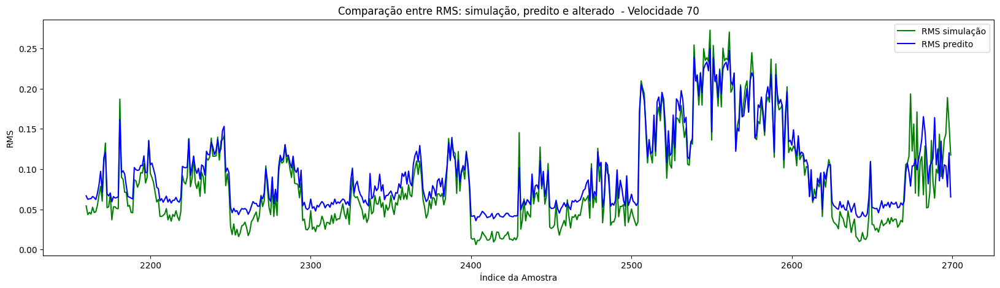

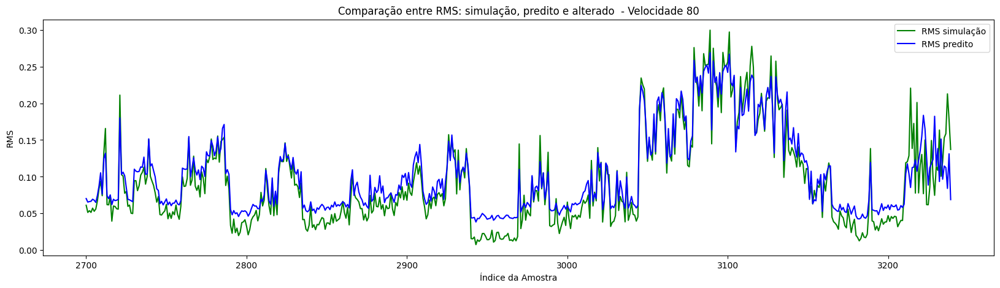

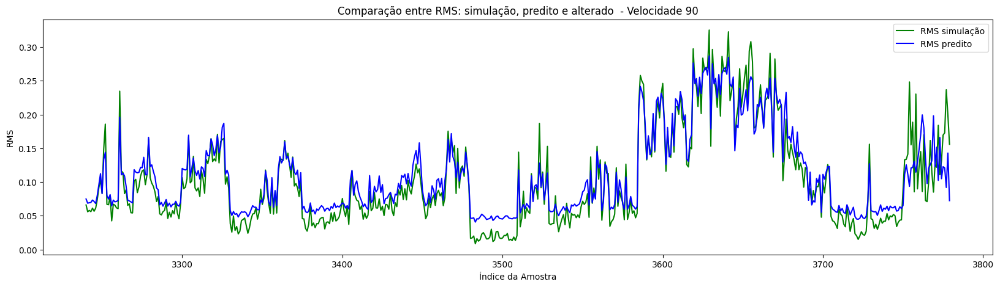

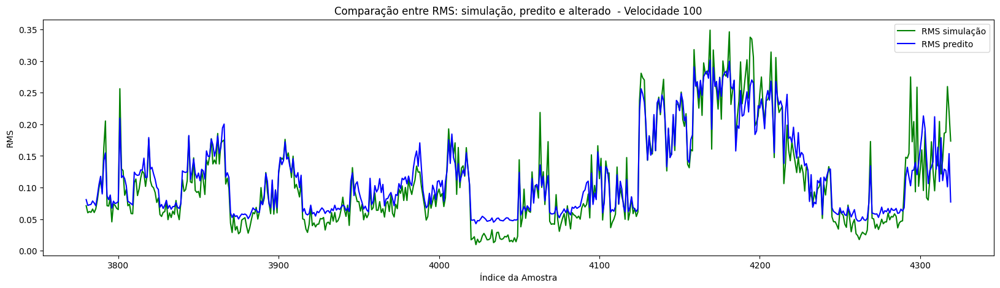

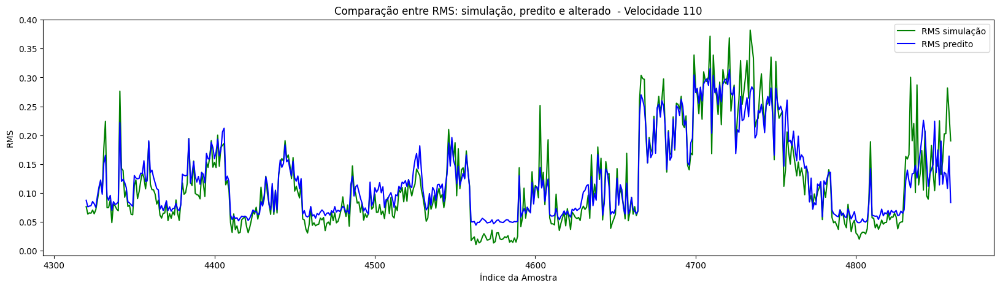

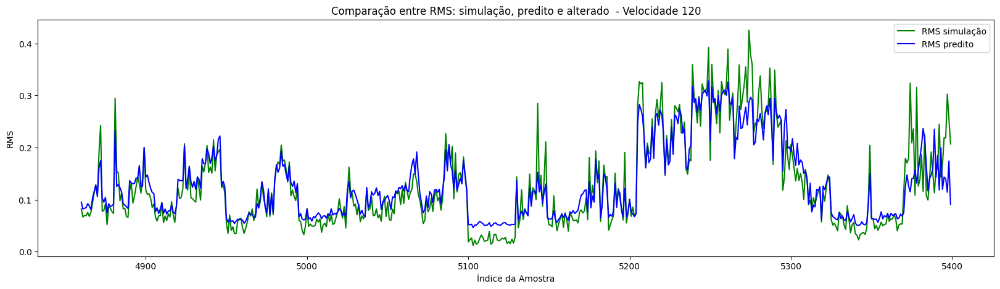

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_C_HB[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_C_HB[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### D-SDN

In [ ]:
y_D_SDN = df_D_SDN.iloc[:, 0]

X_D_SDN = df_D_SDN.iloc[:, 1:8]

y_pred_D_SDN = model.predict(X_D_SDN)

169/169 [==============================] - 0s 2ms/step


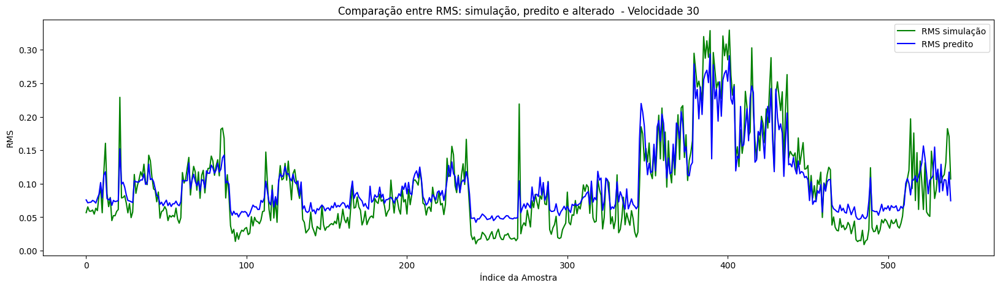

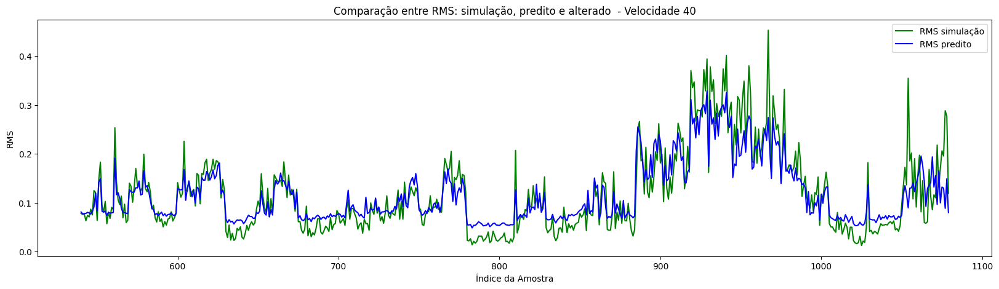

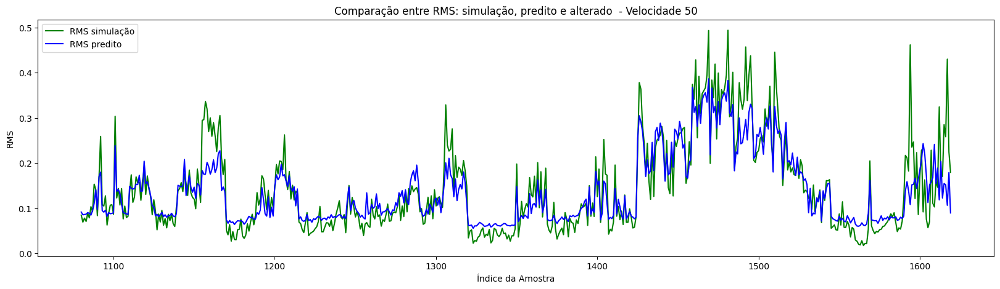

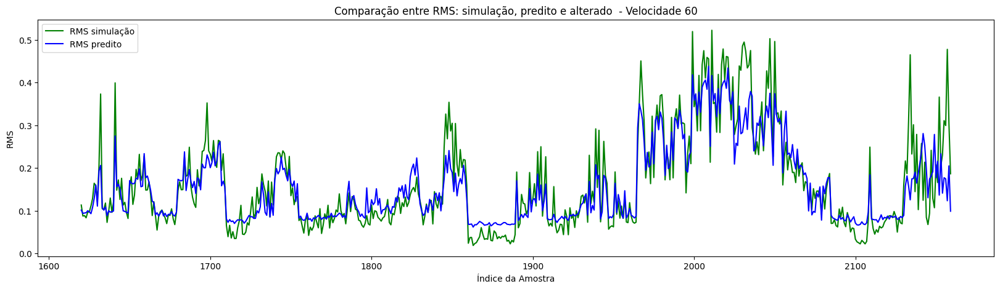

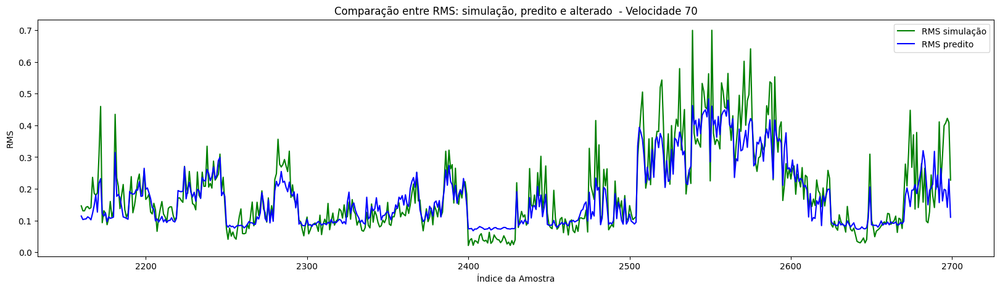

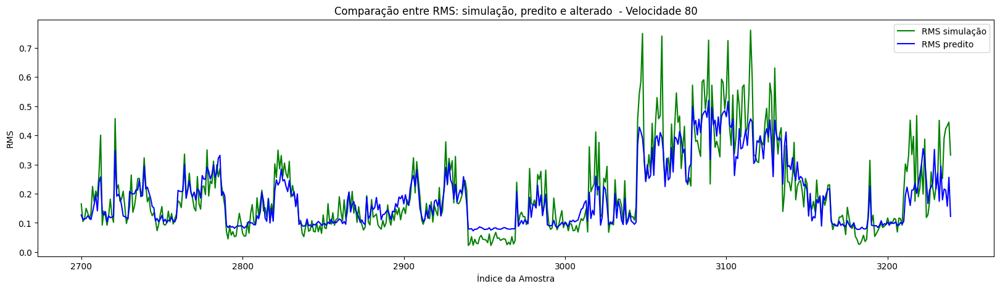

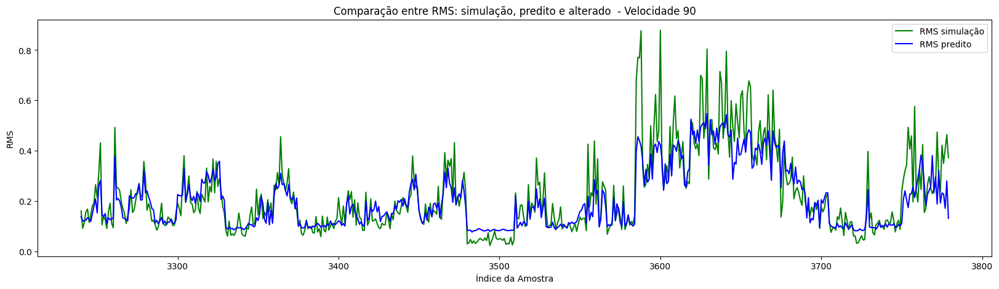

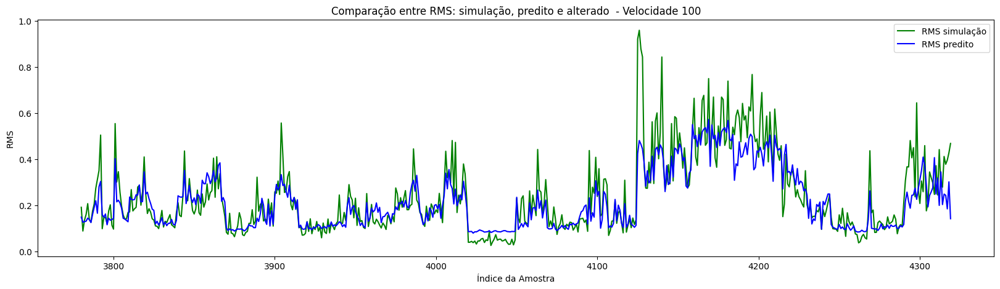

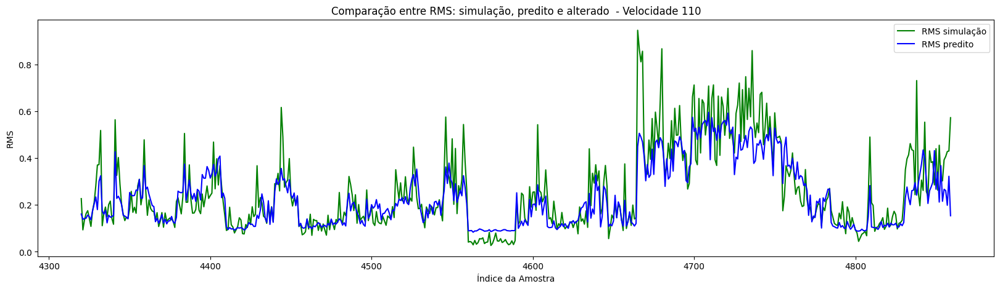

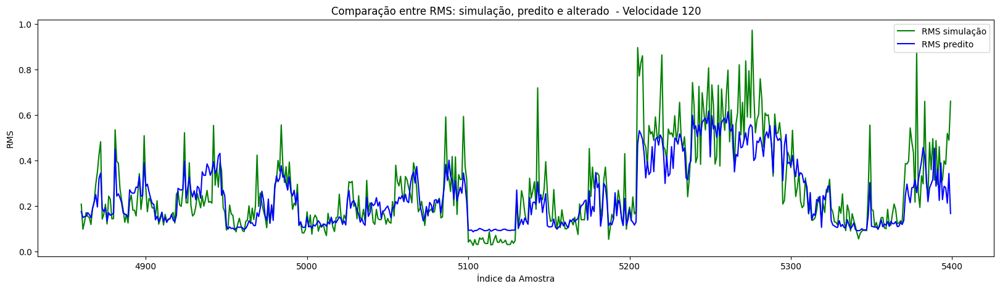

In [ ]:
intervalo_total = 5400

num_subdivisoes = 10

tamanho_subdivisao = intervalo_total // num_subdivisoes

for i in range(num_subdivisoes):
    plt.figure(figsize=(20, 5))

    velocidade = 30 + i * 10

    inicio = i * tamanho_subdivisao
    fim = (i + 1) * tamanho_subdivisao

    plt.plot(range(inicio, fim), y_D_SDN[inicio:fim], label='RMS simulação', color='green')
    plt.plot(range(inicio, fim), y_pred_D_SDN[inicio:fim], label='RMS predito', color='blue')
    plt.legend()
    plt.xlabel('Índice da Amostra')
    plt.ylabel('RMS')
    plt.title(f'Comparação entre RMS: simulação, predito e alterado  - Velocidade {velocidade}')
    plt.show()
    print('\n')

### F-SDN

#SHAP

In [ ]:
# Crie um masker para a RNA
masker = shap.maskers.Independent(data=X)

# Crie um explainer para a RNA com o masker
explainer_rna = shap.ExactExplainer(modelo, masker=masker)

# Obtenha os valores SHAP para um conjunto de teste diretamente do explainer
shap_values_rna = explainer_rna(X)

AttributeError: Exception encountered when calling layer 'sequential_4' (type Sequential).

'tuple' object has no attribute 'rank'

Call arguments received by layer 'sequential_4' (type Sequential):
  • inputs=            IRI         V         k         c        ms       mus       kus
0      0.242190  1.000000  0.635643  0.713457  0.490579  0.504705  0.566038
1      0.204573  1.000000  0.638287  0.411950  0.269139  0.306587  0.566038
2      0.472282  1.000000  0.159704  0.713457  0.702274  0.405646  0.566038
3      0.551517  1.000000  0.096245  0.411950  0.318408  0.306587  0.566038
4      0.012447  0.777778  0.635643  0.713457  0.490579  0.504705  0.566038
...         ...       ...       ...       ...       ...       ...       ...
12795  0.175070  0.555556  0.090957  0.411950  0.406659  0.415552  0.553459
12796  0.175070  0.333333  0.638287  0.411950  0.269139  0.306587  0.566038
12797  0.175070  0.555556  0.387097  0.411950  0.703898  0.702823  0.566038
12798  0.175070  0.555556  0.096245  0.411950  0.318408  0.306587  0.566038
12799  0.175070  0.444444  0.096245  0.411950  0.318408  0.306587  0.566038

[11590 rows x 7 columns]
  • training=None
  • mask=None

['IRI', 'V', 'k', 'c', 'ms', 'mus', 'kus']


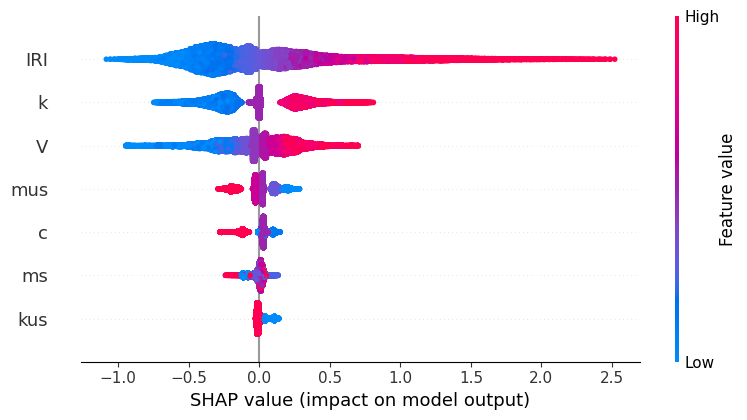

In [ ]:
nomes_primeiras_colunas = df.columns[1:8].tolist()
print(nomes_primeiras_colunas)

shap.summary_plot(shap_values_rna, X, feature_names=nomes_primeiras_colunas)